# Import Essential Libraries

In [1]:
import numpy as np
import timeit
import cv2
from scipy.signal import medfilt, medfilt2d
from scipy.ndimage import median_filter
import matplotlib as mlp
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
font = {'family' : 'sans-serif',
        'weight' : 'bold',
        'size'   : 18}

mlp.rc('font', **font)
#rcParams['font.sans-serif'] = ['Tahoma', 'DejaVu Sans', 'Lucida Grande', 'Verdana']
#from matplotlib import rcParams
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Tahoma']
#matplotlib.rcParams.update({'font.size': 22})

**`Timeit` is more accurate tha `Time` library...**
https://stackoverflow.com/questions/17579357/time-time-vs-timeit-timeit

In [2]:
# Show the colored or Gray-Scale image.
def show_img(image, title, show_shape = True, shape = (10, 8), lim_enabled = True):
    if show_shape:
        print(f"The shape of {title} Image = {image.shape}")
    if image.ndim == 3:
        plt.figure(figsize=shape)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)); plt.axis("off"); plt.title(title); plt.show()
    elif image.ndim == 2:
        plt.figure(figsize=shape)
        if lim_enabled:
            plt.imshow(image, cmap = "gray", vmin = 0, vmax = 255); plt.axis("off"); plt.title(title); plt.show()
        else:
            plt.imshow(image, cmap = "gray"); plt.axis("off"); plt.title(title); plt.show()
    else:
        raise ValueError("Incorrect Dimension")

In [3]:
def plotter(nrows, ncols, img_lst, titles_lst, mode='RGB', figsize = (20, 20), lim_enabled = True):
    fig, ax = plt.subplots(nrows, ncols, figsize = figsize); k = 0
    for i in range(nrows):
        for j in range(ncols):
            if mode == 'RGB':
                if nrows == 1:
                    ax[j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    ax[i].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    ax[i, j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            else:
                if nrows == 1:
                    if lim_enabled:
                        ax[j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[j].imshow(img_lst[k], cmap = "gray")
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    if lim_enabled:
                        ax[i].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i].imshow(img_lst[k], cmap = "gray")
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    if lim_enabled:
                        ax[i,j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i,j].imshow(img_lst[k], cmap = "gray")
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            k += 1
    fig.tight_layout(rect = [0,0,1,0.95])
    plt.show()

# Convert to GRAY scale
def gray(image): return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Question 1

__(50 points)__ The implementation of linear spatial filters requires moving a mask centered at each pixel of the image, computing sum of products of mask coefficients and corresponding pixels. Padding can be used to perform filtering at the corners. Apply all the techniques to `ceramic.jpg`.

The shape of Ceramic Image = (800, 800, 3)


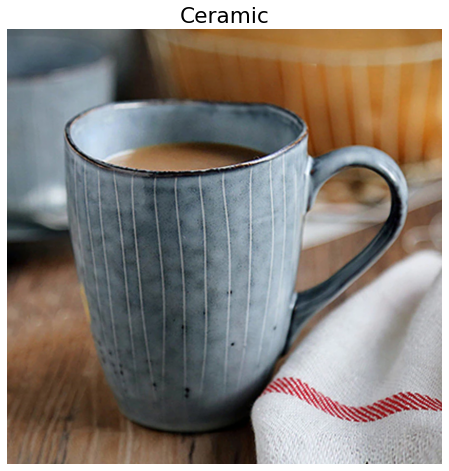

In [79]:
# read image ceramic.jpg
ceramic_im = cv2.imread("../images/ceramic.jpg")
show_img(ceramic_im, title = "Ceramic")

## Question 1.1 - Implement Box-Filter

Implement an algorithm for low-pass filtering a grayscale image by moving a $k \times k$ averaging filter of the form __ones(($k$,$k$))/($k^2$)__.\
Try with $k = 3, 5, 7, 11$ and $13$.\
(Note: Ones(($k$,$k$))/($k^2$) implies a filter with all the entries of a $k \times k$ matrix as $1/(k^2)$.

In [80]:
# Padding function
def padding(im, filter_shape, pad_type = "zero"):
    """
    Input:
        im: Input 2D matrix to be padded
        filter_shape: Size of rectangle-shaped box filter
        pad_type: "zero" / "mirror" / "replicate"
    Output:
        padded image
    """
    # Obtain filter shape
    filter_height, filter_width = filter_shape
    # Obtain image height and width
    im_height, im_width = im.shape
    # Confirm the size of filter and Image
    assert filter_height <= im_height and filter_width <= im_width, "Oops! the filter is bigger than image."
    # extra pad width (for each side)
    pad_width_at_horiz, pad_width_at_vert = round((filter_width - 1)/2), round((filter_height - 1)/2)
    # Switch between types
    if pad_type == "zero":
        imagePadded = np.zeros((im_height + pad_width_at_vert*2, im_width + pad_width_at_horiz*2))
        imagePadded[pad_width_at_vert: -pad_width_at_vert, pad_width_at_horiz: -pad_width_at_horiz] = im
        return imagePadded
    elif pad_type == "mirror":
        rows_to_stack_at_top = np.flipud(im[1:pad_width_at_vert + 1])
        rows_to_stack_at_bottom = np.flipud(im[-pad_width_at_vert-1:-1])
        intermediate_im = np.vstack((rows_to_stack_at_top, im, rows_to_stack_at_bottom))
        cols_to_stack_at_left = np.fliplr(intermediate_im[:, 1:pad_width_at_horiz + 1])
        cols_to_stack_at_right = np.fliplr(intermediate_im[:, -pad_width_at_horiz - 1:-1])
        return np.hstack((cols_to_stack_at_left, intermediate_im, cols_to_stack_at_right))
    elif pad_type == "replicate":
        rows_to_stack_at_top = np.repeat(im[0:1], pad_width_at_vert, axis = 0)
        rows_to_stack_at_bottom = np.repeat(im[-1:], pad_width_at_vert, axis = 0)
        intermediate_im = np.vstack((rows_to_stack_at_top, im, rows_to_stack_at_bottom))
        cols_to_stack_at_left = np.repeat(intermediate_im[:, 0:1], pad_width_at_horiz, axis = 1)
        cols_to_stack_at_right = np.repeat(intermediate_im[:, -1:], pad_width_at_horiz, axis = 1)
        return np.hstack((cols_to_stack_at_left, intermediate_im, cols_to_stack_at_right))
    else:
        raise ValueError("Ooops! Please enter a correct type for Image Padding.\nFor more info see __doc-string__.")

# Implement a low pass filtering on grayscale image.
def imageFiltering(im, box_filter_shape, pad_type = "zero"):
    """
    Input:
        im: Image on which low-pass filter to be applied
        im_filter: BOX Filter to be applied on Image (expected a NUMPY matrix)
        pad_type: "zero" / "mirror" / "replicate"
    Output:
        Filtered image --- Blurry Image
    """
    # Create an empty array
    filtered_im = np.zeros_like(im)
    # Store image shape
    im_shape = im.shape
    # Pad the image
    padded_im = padding(im, (box_filter_shape, box_filter_shape), pad_type)
    # Construct BOX filter
    im_filter = (1/box_filter_shape**2)*np.ones((box_filter_shape, box_filter_shape))
    # Obtain the starting co-ordinate of IMAGE
    pad = box_filter_shape//2
    for i in range(im_shape[0]):
        for j in range(im_shape[1]):
            filtered_im[i, j] = np.sum(im_filter * padded_im[i: i + 2*pad + 1, j:j + 2*pad + 1])
    return filtered_im

In [81]:
# Convert ceramic.jpg to GRAYSCALE
ceramic_gray = gray(ceramic_im)

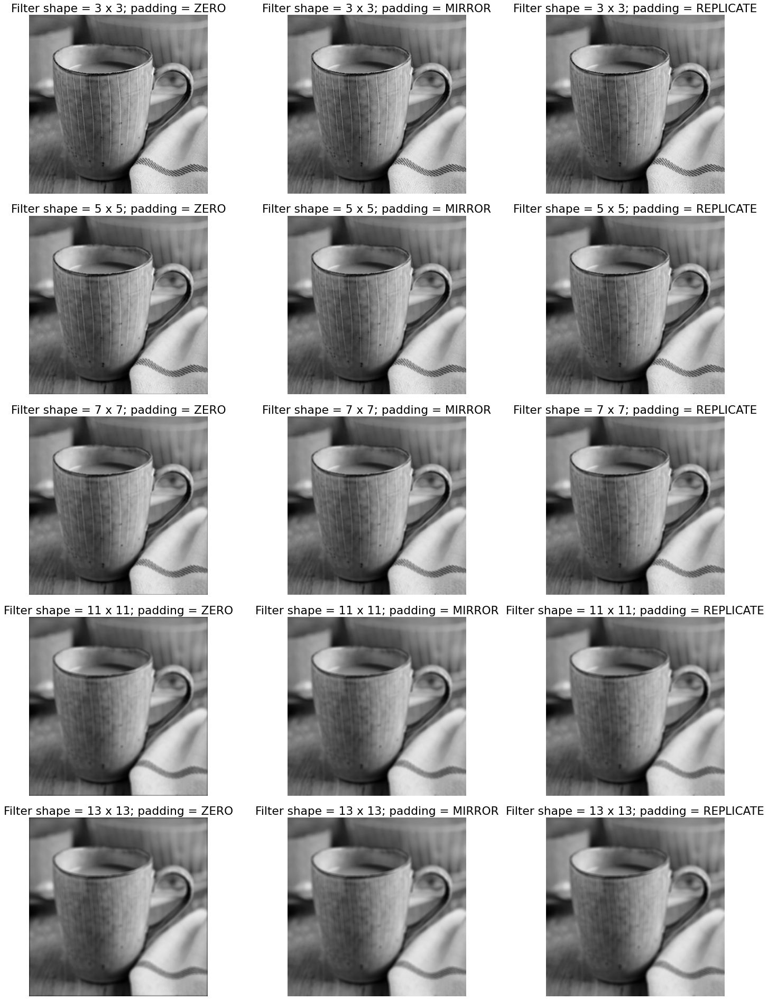

In [83]:
# Define a BOX-filter of shape from user input.
#filter_shape = int(input(f"Enter the BOX-filter shape: "))
shapes = [3,5,7,11,13]
fig, ax = plt.subplots(nrows = len(shapes), ncols = 3, figsize = (22, 28))
for k, filter_shape in enumerate(shapes):
    filtered_im_zero = imageFiltering(ceramic_gray, filter_shape, pad_type = "zero")
    filtered_im_mirror = imageFiltering(ceramic_gray, filter_shape, pad_type = "mirror")
    filtered_im_replicate = imageFiltering(ceramic_gray, filter_shape, pad_type = "replicate")
    ax[k, 0].imshow(filtered_im_zero, cmap = "gray", vmin = 0, vmax = 255)
    ax[k, 0].set_title(f"Filter shape = {filter_shape} x {filter_shape}; padding = ZERO")
    ax[k, 0].set_axis_off()
    ax[k, 1].imshow(filtered_im_mirror, cmap = "gray", vmin = 0, vmax = 255)
    ax[k, 1].set_title(f"Filter shape = {filter_shape} x {filter_shape}; padding = MIRROR")
    ax[k, 1].set_axis_off()
    ax[k, 2].imshow(filtered_im_replicate, cmap = "gray", vmin = 0, vmax = 255)
    ax[k, 2].set_title(f"Filter shape = {filter_shape} x {filter_shape}; padding = REPLICATE")
    ax[k, 2].set_axis_off()
fig.tight_layout(rect = [0,0,1,0.95]); plt.show()

## Question 1.2 - Implement Efficient Box-Filtering

As the filter is moved from one spatial location to the next one, the filter window shares many common pixels in adjacent neighborhoods. Exploit this observation and implement a more efficient version of averaging filter.

**Idea:**

Maintaining a list to store the sum of already computed values that are common in the current and next filter operation, and using them in the next operation of the filter to compute the next step output.

In [108]:
def arr_addition(arr):
    """Add all elements of an ARRAY."""
    s = 0
    for i in arr:
        for j in i:
            s += j
    return s

In [109]:
# Implement a low pass filtering on grayscale image.
def vanillaBoxFiltering(im, box_filter_shape, pad_type = "zero"):
    """
    Input:
        im: Image on which low-pass filter to be applied
        im_filter: BOX Filter to be applied on Image (expected a NUMPY matrix)
        pad_type: "zero" / "mirror" / "replicate"
    Output:
        Filtered image --- Blurry Image
        Time taken for Convolution...
    """
    # Create an empty array
    filtered_im = np.zeros_like(im)
    # Store image shape
    im_shape = im.shape
    # Pad the image
    padded_im = padding(im, (box_filter_shape, box_filter_shape), pad_type)
    start = timeit.default_timer()
    for i in range(im_shape[0]):
        for j in range(im_shape[1]):
            filtered_im[i, j] = arr_addition(padded_im[i:i + box_filter_shape, j:j + box_filter_shape])/(box_filter_shape**2)
    stop = timeit.default_timer()
    return filtered_im, (stop - start)

In [110]:
def efficientBoxConvolution(image, kernel_size, pad_type = "zero"):
    """Return Time taken for Convolution and Convolution Results..."""
    # Construct BOX Kernel -- not required as we intend to make it efficient we just sum up all the entries of 
    # image patch and divide it by k**2, which is nothing but same as applying BOX kernel.
    # Padding for BOX Kernel.
    output = np.zeros_like(image)
    # Store image shape
    im_shape = image.shape
    # Pad the image
    pad_img = padding(image, (kernel_size, kernel_size), pad_type)
    # Start timer
    start = timeit.default_timer()
    # Apply Efficient BOX Convolution...
    for i in range(im_shape[0]):
        # List to store sum for one travel from left to right.
        sum_p = []
        for j in range(im_shape[1]):
            if j == 0:# For the left extreme convolution.
                for kk in range(kernel_size):
                    sum_p.append(arr_addition(image[i:i + kernel_size, kk:kk+1]))
                output[i,j] = np.sum(sum_p)/(kernel_size**2)
            else:
                sum_p.append(arr_addition(image[i:i + kernel_size, (j + kernel_size -1): (j + kernel_size)]))
                output[i,j] = np.sum(sum_p[-kernel_size:])/(kernel_size**2)
    # Stop the timer
    stop = timeit.default_timer()
    return output, (stop - start)

## Question 1.3 - Plot of $k$ vs Run-time for Different Sized Images

To appreciate the benefits of the efficient version, generate a plot of $k$ vs run-time for multiple images of different sizes ($8\times8$, $16\times16$, $32\times32$, $\ldots$, $512\times512$) by resizing `ceramic.jpg`. The plot diagram should contain a line plot for each image size. Use different marker types to distinguish the default implementation and improved
implementation.\
Just to give you a rough idea, look at https://imgur.com/a/0HtYlTE.

https://stackoverflow.com/questions/14720331/how-to-generate-random-colors-in-matplotlib

https://www.kite.com/python/answers/how-to-generate-random-colors-in-matplotlib-in-python

In [111]:
# FUnction to Plot the Time Efficient for Different Filter sizes.
def plotEfficient(images, kernel_sizes, t_vanilla, t_improved, colors, title, figsize = (10, 10)):
    # generate n random colors...
    #colors = np.random.rand(len(images),3)
    # Generate a figure...
    plt.figure(figsize=figsize)
    # Plots for each image.
    for i in range(len(images)):
        plt.plot(kernel_sizes, t_vanilla[i], color = colors[i], label = 'Vanilla Filter (' + 
                 str(images[i].shape[0]) + ' x ' + str(images[i].shape[1]) + ')')
        plt.plot(kernel_sizes, t_improved[i], color = colors[i], linestyle = '--', label = 'Efficient Filter (' + 
                 str(images[i].shape[0]) + ' x ' + str(images[i].shape[1]) + ')')
    plt.xticks(kernel_sizes)
    plt.title(title)
    plt.xlabel("Kernel size (k)")
    plt.ylabel("Run time (in sec)")
    plt.legend(loc="best", bbox_to_anchor=(1.2, 0.6))
    plt.grid()
    plt.show()

In [112]:
# List containing Shapes for Image.
image_shapes = [2**k for k in range(4, 9)]
# Different Shaped Images...
images = [cv2.resize(ceramic_gray, (shape, shape)) for shape in image_shapes]
# Kernel Sizes to be applied on each Images.
kernel_sizes = [3, 5, 7, 11, 13]

# Time List for Efficient and Vanilla Filtering...
time_vanilla = []
time_improved = []

for i in range(len(images)):       
    time1 = []# for vanilla.
    time2 = []# for Improved.

    for k in kernel_sizes:
        _, vanillaTime = vanillaBoxFiltering(images[i], k, pad_type = "zero")
        time1.append(vanillaTime)

        _, efficientTime = efficientBoxConvolution(images[i], k, pad_type = "zero")
        time2.append(efficientTime)

    time_vanilla.append(time1)
    time_improved.append(time2)

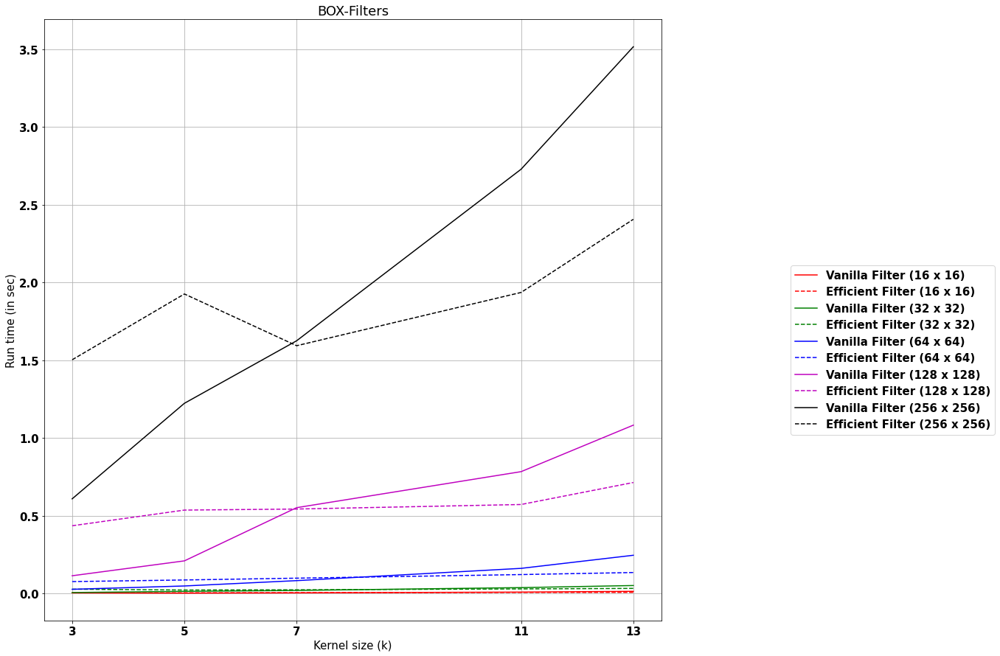

In [113]:
# Plot the Time takes for Different filter for Different sized Images...
mlp.rcParams.update({'font.size': 15})
# define colors list
colors = ["r", "g", "b", "m", "k"]
plotEfficient(images, kernel_sizes, time_vanilla, time_improved, colors, title = "BOX-Filters", figsize = (15, 15))

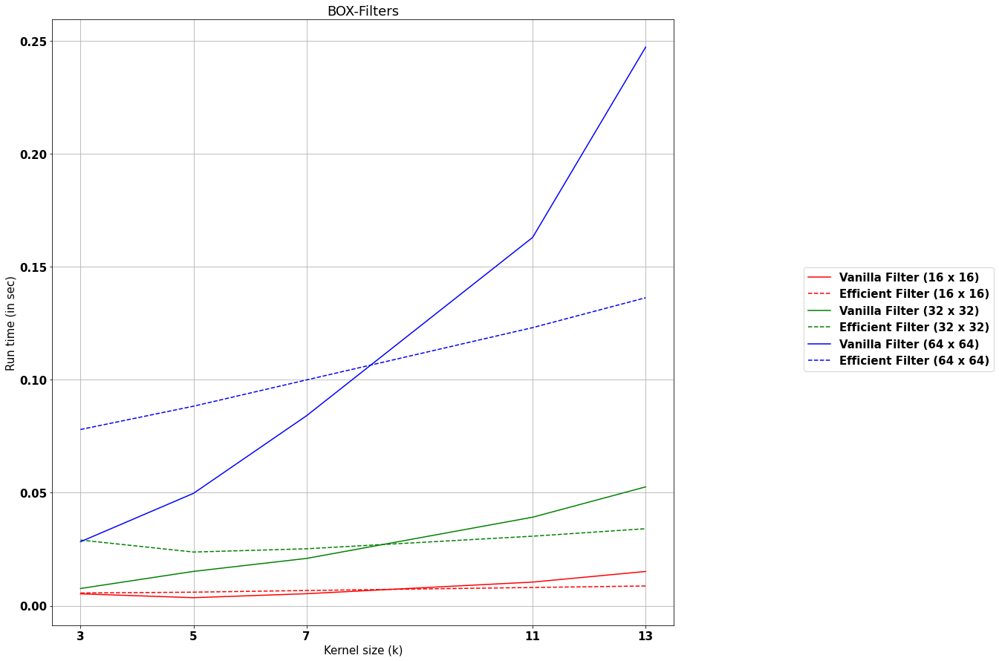

In [114]:
#Zoomed Version...
plotEfficient(images[:3], kernel_sizes, time_vanilla[:3], time_improved[:3], colors[:3], title = "BOX-Filters", figsize = (15, 15))

## Question 1.4 - Efficient Median Filter

Utilize the observation similar to above to implement an efficient version of a $k \times k$ median filter. Generate a plot figure similar to previous question.

https://stackoverflow.com/questions/63322986/speed-up-python-programs-adaptive-median-filter

https://stackoverflow.com/questions/41851044/python-median-filter-for-1d-numpy-array

https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.median_filter.html

https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.medfilt.html

Look for Chat at Below:

https://stackoverflow.com/questions/60309377/multithreading-1d-median-filtering-in-python

In [227]:
# def Median filtering...
def medianFiltering(im, k, median_filtering_type = "numpy", pad_type = "zero"):
    """
    image: Image on which median filter is to be applied.
    k: Filter Shape.
    """
    if median_filtering_type == "numpy":
        # Create an empty array
        filtered_im = np.zeros_like(im)
        # Pad the image
        padded_im = padding(im, (k, k), pad_type)
        # Store image shape
        im_shape = im.shape
        for i in range(im_shape[0]):
            for j in range(im_shape[1]):
                filtered_im[i, j] = np.median(padded_im[i: i + k, j:j + k])
    elif median_filtering_type == "medfilt2d":
        return scipy.signal.medfilt2d(im, kernel_size=k)
    elif median_filtering_type == "medfilt":
        return scipy.signal.medfilt(im, kernel_size=k)
    elif median_filtering_type == "ndimage_medfilt":
        return scipy.ndimage.median_filter(im, size=k)
    return filtered_im

In [87]:
# List containing Shapes for Image.
image_shapes = [2**k for k in range(4, 9)]
# Different Shaped Images...
images = [cv2.resize(ceramic_gray, (shape, shape)) for shape in image_shapes]
# Kernel Sizes to be applied on each Images.
kernel_sizes = [3, 5, 7, 11, 13]

# Time List for Efficient and Vanilla Filtering...
time_vanilla = []
time_improved = []

for i in range(len(images)):       
    time1 = []# for vanilla.
    time2 = []# for Improved.

    for k in kernel_sizes:
        start1 = timeit.default_timer() 
        median_lowpass_image = medianFiltering(images[i], k, median_filtering_type = "numpy")
        stop1 = timeit.default_timer()
        time1.append(stop1 - start1)

        start2 = timeit.default_timer() 
        median_lowpass_image = medianFiltering(images[i], k, median_filtering_type = "medfilt2d")
        stop2 = timeit.default_timer()
        time2.append(stop2 - start2)

    time_vanilla.append(time1)
    time_improved.append(time2)

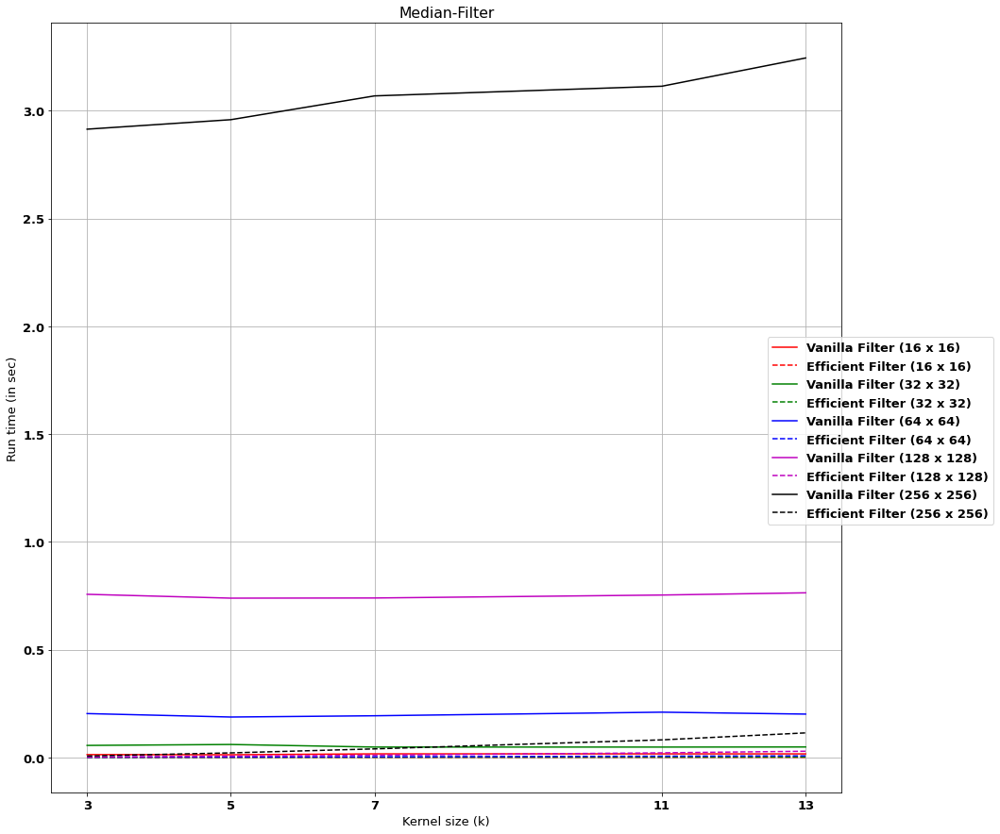

In [92]:
# Plot the Time takes for Different filter for Different sized Images...
mlp.rcParams.update({'font.size': 13})
# define colors list
colors = ["r", "g", "b", "m", "k"]
plotEfficient(images, kernel_sizes, time_vanilla, time_improved, colors, title = "Median-Filter", figsize = (15, 15))

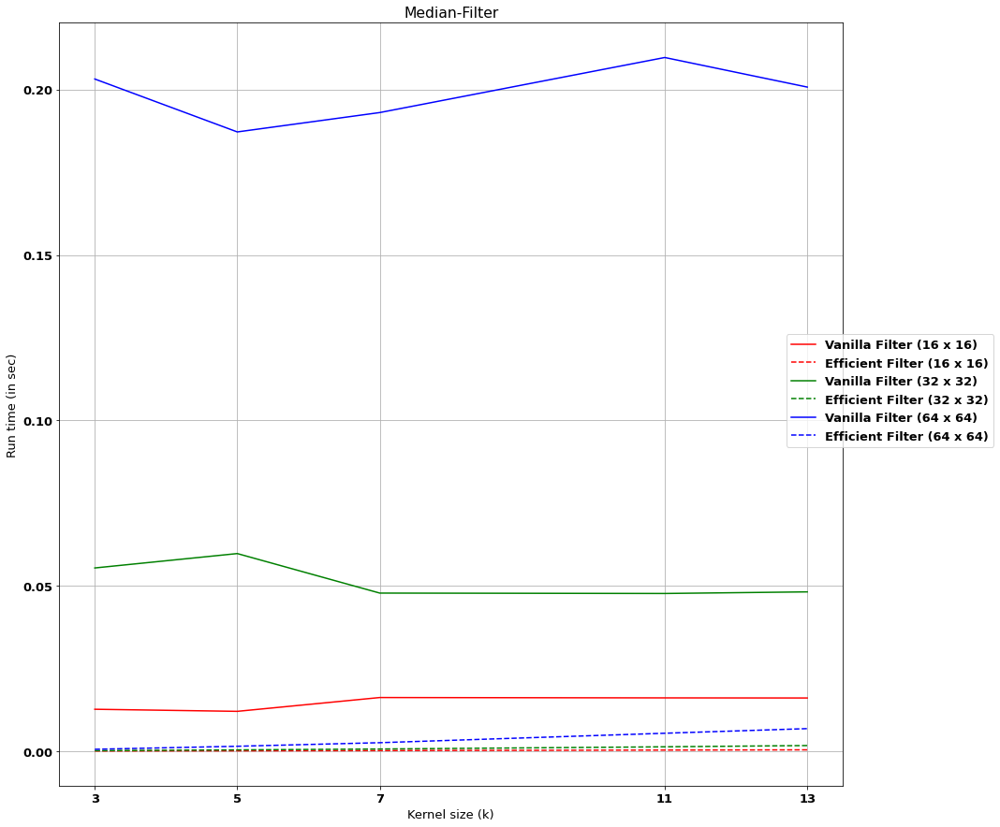

In [93]:
#Zoomed Version...
plotEfficient(images[:3], kernel_sizes, time_vanilla[:3], time_improved[:3], colors[:3], title = "Median-Filter", figsize = (15, 15))

## Question 1.5 - Clean `brainNoisy.jpg`

After observing the image `brainNoisy.jpg`, answer the following questions:
* Which filter will be the best suited to remove the noise and why?
* Experiment with different filter sizes and report your observations. Which filter size is optimal?
* Get `brainNoisy.jpg` to resemble the original `brain.jpg` as much as possible by removing the noise.

1. `Median` filter will be best suited to remove the noise without degrading the image "clarity" much. As `brainNoisy.jpg` consists of `salt` noise (which are of pixel intensity = 255), using **median** filter remove all those **high intensity or low intensity artefacts** in image.

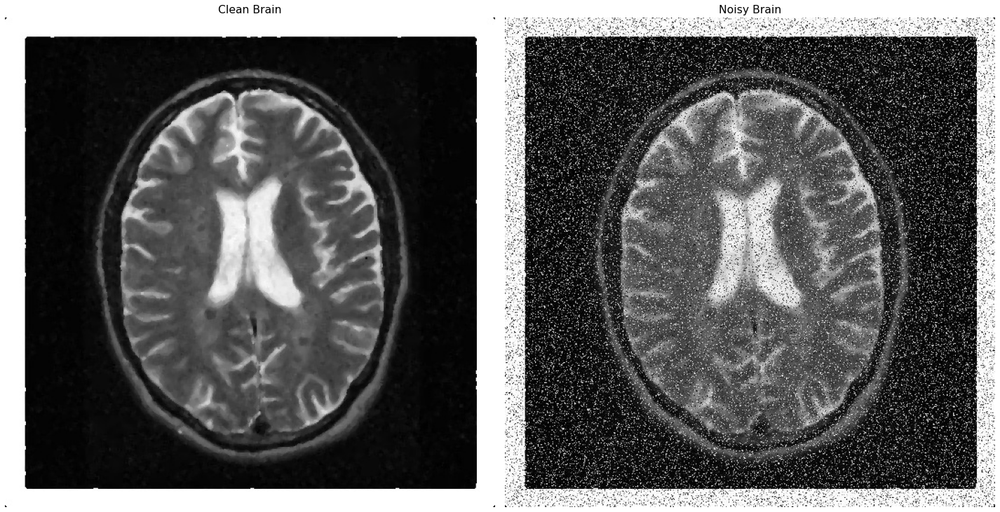

In [91]:
#read BrainNoisy Image...
brainNoisy = cv2.imread("../images/brainNoisy.jpg")
brain = cv2.imread("../images/brain.jpg")
plotter(1, 2, [brain, brainNoisy], ["Clean Brain", "Noisy Brain"])

In [94]:
# Convert noisy brain to one dimensional by converting it to gray-scale.
brainNoisy_gray = gray(brainNoisy)
brain_gray = gray(brain)

# Kernel Sizes to be applied on each Images.
kernel_sizes = [3, 5, 7, 11, 13]

#store the images.
brain_clean_lst = [brain]
brain_clean_lst_titles = [f"Kernel Size = {k} x {k}" for k in kernel_sizes]
brain_clean_lst_titles.insert(0, "Original")

# apply k-median filters iteratively.
for k in kernel_sizes:
    brain_clean_lst.append(medianFiltering(brainNoisy_gray, k, median_filtering_type = "numpy"))

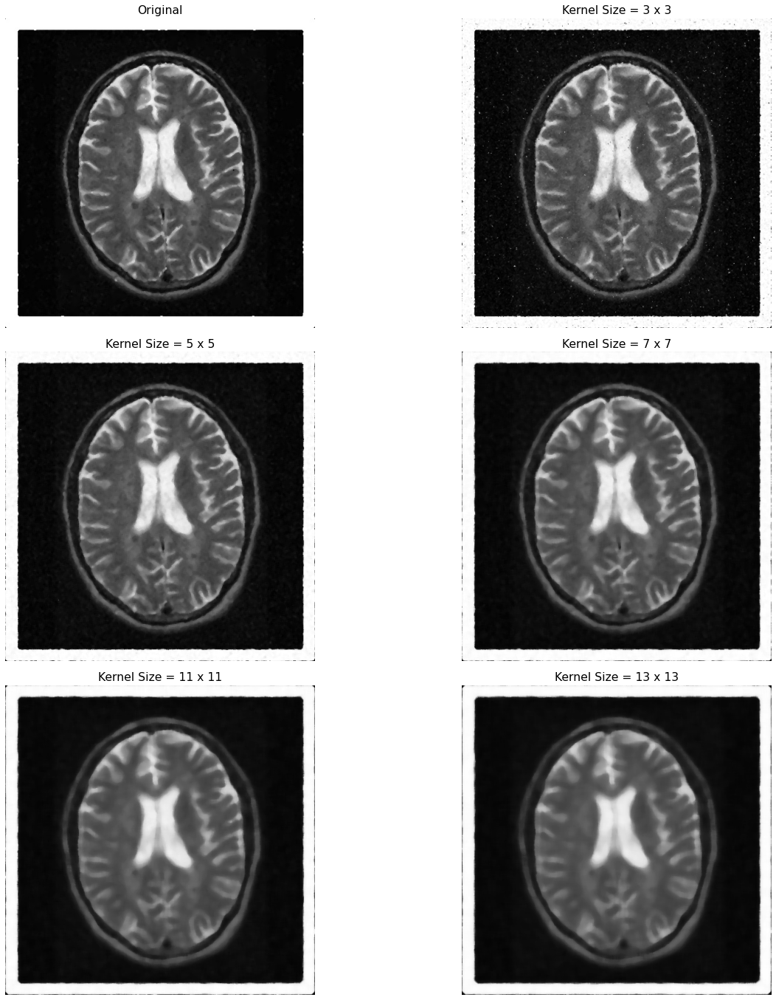

In [95]:
# Plot the Images...
plotter(3, 2, brain_clean_lst, brain_clean_lst_titles, mode = "GRAY", lim_enabled = False)

**As per our observation, FILTER SHAPE $ = 5 \times 5$ seems to be optimal, as it closely resembles the given CLEAN BRAIN image.**

# Question 2

__(60 points)__ Edge Detection

## Question 2.1 - Canny Edge Detection

Read about __Canny Edge detector__. Apply the Canny edge detector (use inbuilt `cv2.Canny` function for this task) to `cup.jpg`.
(You can read about the Canny Edge Detector here : [Canny Edge Detector](https://justin-liang.com/tutorials/canny/))

The shape of Cup Image = (334, 500, 3)


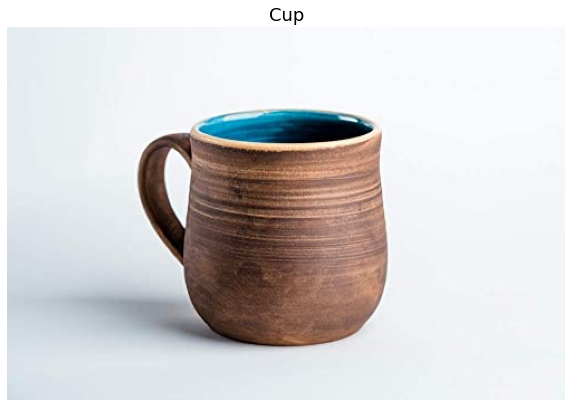

In [115]:
cup_im = cv2.imread("../images/cup.jpg")
show_img(cup_im, title = "Cup")

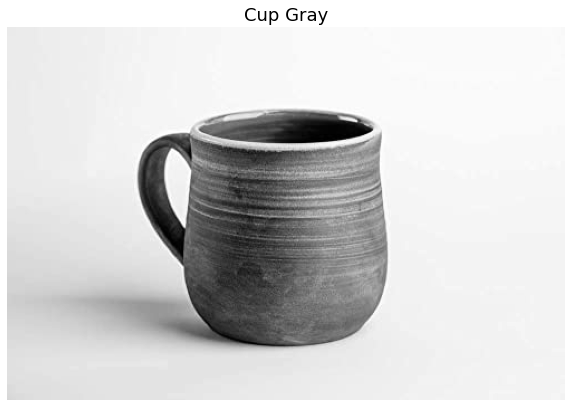

In [116]:
# Convert Cup to GRAYSCALE.
cup_gray = gray(cup_im)
show_img(cup_gray, title = "Cup Gray", show_shape = False, shape = (10, 8))

## Question 2.2 - Tuning Canny Params

Tweak the values of the arguments (`minVal` and `maxVal`), and report the values. that give the best results for each image. (Hint: Try to get a good outline of the cup without too many fine lines.)

In [41]:
# Detect Edge of the cup using cv2.Canny() for a range of upper and lower thresholds.
t_upper = list(range(240, 255, 10))
t_lower = list(range(170, 210, 10))
cup_edges = []; vals = []
for maxVal in t_upper:
    for minVal in t_lower:
        if minVal < maxVal:
            cup_edges.append(cv2.Canny(cup_gray, minVal, maxVal))
            vals.append([minVal, maxVal])

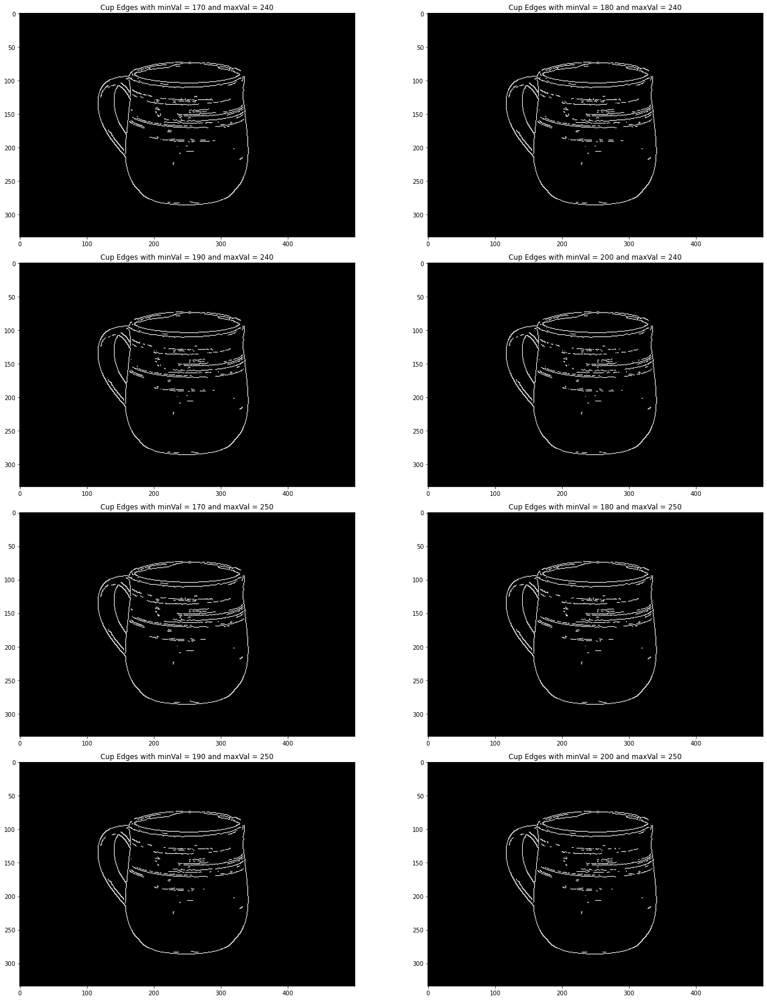

In [45]:
# Show all the images...
fig, ax = plt.subplots(nrows = 4, ncols = 2, figsize = (20, 25)); k = 0
for i in range(4):
    for j in range(2):
        ax[i, j].imshow(cup_edges[k], cmap = "gray", vmin = 0, vmax = 255)
        ax[i, j].set_title(f"Cup Edges with minVal = {vals[k][0]} and maxVal = {vals[k][1]}")
        k += 1
fig.tight_layout(rect = [0,0,1,0.95])
plt.show()

__Best values obtained for above Edge Detection task: minVal $= 190$ and maxVal $= 250$.__

## Question 2.3 - Implementing Roberts, Prewitt, Sobel and Laplacian filters

Consider __Roberts__, **Prewitt**, **Sobel** and __Laplacian filters__ discussed in the class. Implement and apply these filters on `girl.jpg`. and make observations upon comparing their outputs. Compare these with the output of _Canny edge detector_ on the same image.
(You can read more about the Roberts filter here : [Roberts Filter](https://homepages.inf.ed.ac.uk/rbf/HIPR2/roberts.htm))

In [117]:
# Define convolution function: 2D Convolution.
def convolve2D(image, kernel, padding="auto", strides=1):
    """
    Convolve the "kernel" upon the given "image" with given "padding" and "strides".
    Output:
        Convolved Image.
    """
    kernel = np.flipud(np.fliplr(kernel))

    # Gather Shapes of Kernel + Image + Padding
    xKernShape = kernel.shape[0]
    yKernShape = kernel.shape[1]
    xImgShape = image.shape[0]
    yImgShape = image.shape[1]
    
    # Shape of Output Convolution
    if padding == "auto":
        pad_x = xKernShape // 2
        pad_y = yKernShape // 2
        xOutput = round((xImgShape - xKernShape + 2 * pad_x) / strides) + 1
        yOutput = round((yImgShape - yKernShape + 2 * pad_y) / strides) + 1
        output = np.zeros((xOutput, yOutput))
    elif isinstance(padding, (int)):
        xOutput = int(((xImgShape - xKernShape + 2 * padding) / strides) + 1)
        yOutput = int(((yImgShape - yKernShape + 2 * padding) / strides) + 1)
        output = np.zeros((xOutput, yOutput))
    else:
        raise ValueError("Enter the value for padding correctly - Either \"auto\" or any non-negative integer.")

    # Apply Equal Padding to All Sides
    if padding == "auto":
        pad_x, pad_y = xKernShape // 2, yKernShape // 2
        imagePadded = np.zeros((xImgShape + pad_x*2, yImgShape + pad_y*2))
        imagePadded[pad_x: -pad_x, pad_y: -pad_y] = image
    elif isinstance(padding, (int)) and padding != 0:
        imagePadded = np.zeros((xImgShape + padding*2, yImgShape + padding*2))
        imagePadded[padding: -padding, padding: -padding] = image
    else:
        imagePadded = image
        
        
    # Iterate through padded image
    for y in range(yOutput):
        # Only Convolve if y has gone down by the specified Strides
        if y % strides == 0:
            for x in range(xOutput):
                try:
                    # Only Convolve if x has moved by the specified Strides
                    if x % strides == 0:
                        output[x, y] = (kernel * imagePadded[x: x + xKernShape, y: y + yKernShape]).sum()
                except:
                    break

    return output.astype(np.int64)# don't keep it as uint8 rather as int64 because during convolving edge detection filter we might get negative values.

The shape of Girl Image = (513, 342, 3)


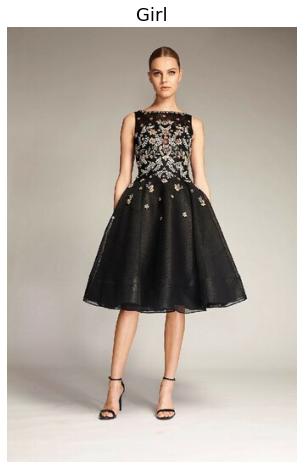

In [119]:
# read the girl.jpg image
girl_im = cv2.imread("../images/girl.jpg")
show_img(girl_im, title="Girl", show_shape = True, shape = (10, 8))

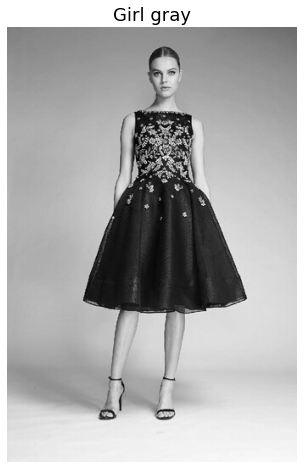

In [120]:
# Convert the RGB image of Girl to Grayscale image.
girl_gray = gray(girl_im)
show_img(girl_gray, title="Girl gray", show_shape = False, shape = (10, 8))

In [227]:
# def function that combine both x and y direction Sobel, Prewitt, and Robert filter...
def combine_gradient_filter(image, x_filter, y_filter, threshold):
    """
    Apply M_x and M_y filter to image and combine them together by taking their sum of 
    squares to obtain the final image after thresholding.
    Output:
        Edge detected Image.
    """
    # padding required both in x and y direction are same (as both filters are of same shape).
    if x_filter.shape[0]%2 != 0:#for odd shaped filters.
        padding = x_filter.shape[0]//2
    else:# for filter shape 2.
        padding = 1
    # Calculate the gradients.
    G_x = convolve2D(image, x_filter, padding=padding)
    G_y = convolve2D(image, y_filter, padding=padding)
    # magnitude of Gradients.
    mag = np.sqrt(G_x**2 + G_y**2)
    # Apply threshold to obtain Edges in Image.
    return ((mag > threshold).astype(np.uint8))*255

In [217]:
# Define Prewitt, Sobel, and Robert filters.
prewitt_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
prewitt_y = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])
robert_x = np.array([[0, 1], [-1, 0]])
robert_y = np.array([[1, 0], [0, -1]])
laplacian_ver_1 = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]])
laplacian_ver_2 = np.array([[1, 1, 1], [1, -8, 1], [1, 1, 1]])

Normally these filters are producing array with gradient values for both x and y direction. Now at edges gradient would be high and hence taking their root sum of squares basically combines the effect in both directions and does one great thing by transforming it into positive values.
Now apply a threshold to partition gradient-magnitude values into two part, one above threshold are where we are confident in presence of edges and on other side no edges -- completely black.

__Prewitt-Edge effect...__

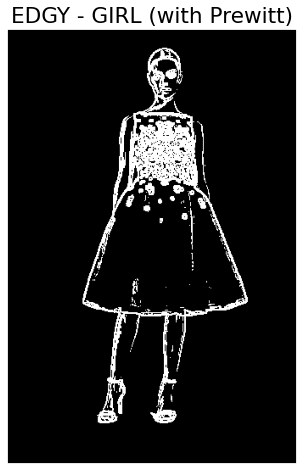

In [291]:
# Apply Prewitt and visualize the effect.
prewitt_edge_girl = combine_gradient_filter(girl_gray, prewitt_x, prewitt_y, 75)
show_img(prewitt_edge_girl, title = "EDGY - GIRL (with Prewitt)", show_shape = False)

__Robert-Edge effect...__

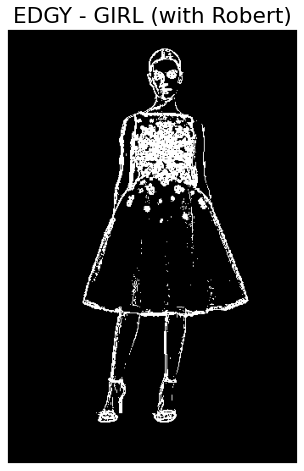

In [292]:
# Apply Prewitt and visualize the effect.
robert_edge_girl = combine_gradient_filter(girl_gray, robert_x, robert_y, 25)
show_img(robert_edge_girl, title = "EDGY - GIRL (with Robert)", show_shape = False)

__Sobel-Edge effect...__

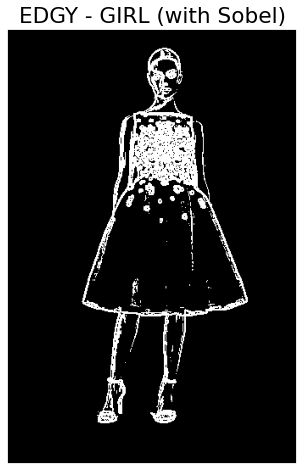

In [293]:
# Apply Prewitt and visualize the effect.
sobel_edge_girl = combine_gradient_filter(girl_gray, sobel_x, sobel_y, 100)
show_img(sobel_edge_girl, title = "EDGY - GIRL (with Sobel)", show_shape = False)

##### Analysis...

1. With `Sobel` and `Prewitt` we obtained approximately similar type of edgy-images with threshold 75 and 100, respectively.
2. While for `Robert` filter we obtained edges with some **blurry** effect and that too with a lower threshold.
3. Hence, we conclude that the `Robert` filter doesn't produce pronounced magnitude of gradient at places where edges are there as the gradient is measured taking difference of two consecutive diagonal pixels. Considering only two pixels with no additional weights to them and that too diagonally results lower gradient values.  
4. While this is not so in case for `Sobel` and `Prewitt`, where `Sobel` does output higher magnitude gradient values than `Prewitt` due to the importance it give out to the immediate neighboring pixels (up-down and right-left) that are two-pixel apart.

In [238]:
## Apply Laplacian also............................
laplacian_ver_1_grad = np.clip(convolve2D(girl_gray, laplacian_ver_1), a_min = 0, a_max = 255)
laplacian_ver_2_grad = np.clip(convolve2D(girl_gray, laplacian_ver_2), a_min = 0, a_max = 255)

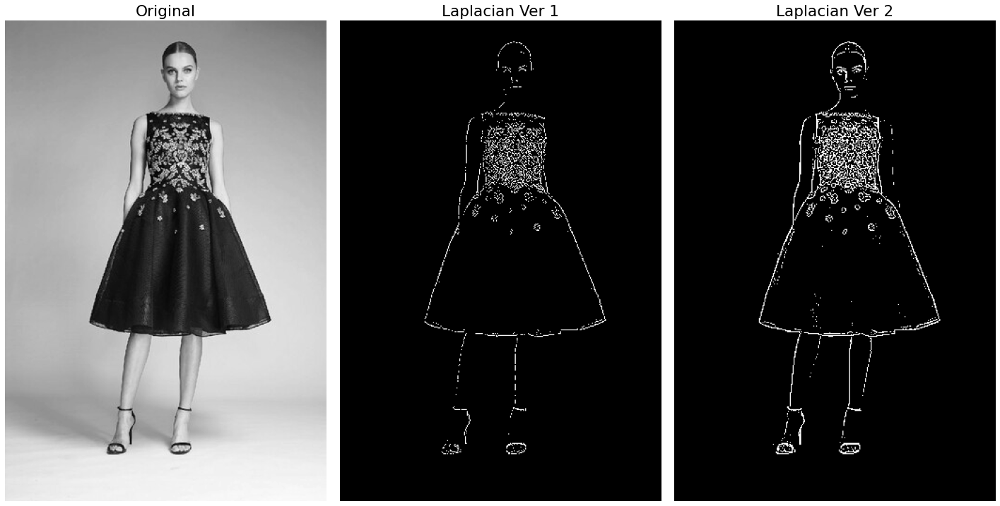

In [246]:
# apply thresholding to create binary image.
lap1_thresh, lap2_thresh = 100, 120
lapver1_girl = ((laplacian_ver_1_grad > lap1_thresh).astype(np.uint8))*255
lapver2_girl = ((laplacian_ver_2_grad > lap2_thresh).astype(np.uint8))*255

# Show the Image...
plotter(1, 3, [girl_gray, lapver1_girl, lapver2_girl], ["Original", "Laplacian Ver 1", "Laplacian Ver 2"],
        mode = "GRAY", lim_enabled = False)

**Since `Version 1 Laplacian filter` consider only horizontal and vertical neighbor pixels, we can see `edges parallel to x and y direction`. But in `Version 2` since diagonal pixels are taken into account, we can see edges that are at an angle to x and y axis.**

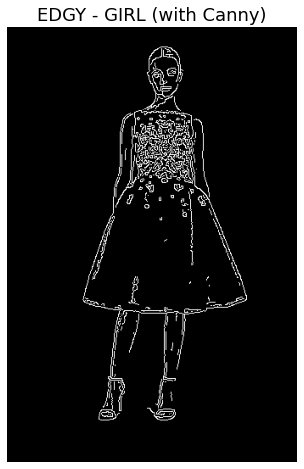

In [133]:
# Applying CANNY edge detection...
canny_edge_girl = cv2.Canny(girl_gray, 90, 140)
show_img(canny_edge_girl, title = "EDGY - GIRL (with Canny)", show_shape = False)

## Question 2.4 - 5\*5 Sobel and Prewitt

What will the $5\times5$ variants of __Sobel__ and __Prewitt__ filters look like? Apply these larger filters on `girl.jpg` and make observations upon comparing their outputs with the corresponding smaller filters.

https://www.iasj.net/iasj/download/3e89a315575ed098

https://www.researchgate.net/publication/49619233_Image_Segmentation_using_Extended_Edge_Operator_for_Mammographic_Images

http://www.hlevkin.com/hlevkin/articles/SobelScharrGradients5x5.pdf

In [272]:
sobel_5y = np.array([[  5.,   8.,  10.,   8.,   5.],
                     [  4.,  10.,  20.,  10.,   4.],
                     [  0.,   0.,   0.,   0.,   0.],
                     [ -4., -10., -20., -10.,  -4.],
                     [ -5.,  -8., -10.,  -8.,  -5.]])

sobel_5x = np.array([[ -5.,  -4.,  0.,   4.,   5.],
                     [ -8., -10.,  0.,  10.,   8.],
                     [-10., -20.,  0.,  20.,  10.],
                     [ -8., -10.,  0.,  10.,   8.],
                     [ -5.,  -4.,  0.,   4.,   5.]])

prewitt_5y = np.array([[ 2,  2,  2,  2,  2],
                       [ 1,  1,  1,  1,  1],
                       [ 0,  0,  0,  0,  0],
                       [-1, -1, -1, -1, -1],
                       [-2, -2, -2, -2, -2]])

prewitt_5x = np.array([[-2, -1,  0,  1,  2],
                       [-2, -1,  0,  1,  2],
                       [-2, -1,  0,  1,  2],
                       [-2, -1,  0,  1,  2],
                       [-2, -1,  0,  1,  2]])

In [289]:
# Compute Edges with these 5*5 filters...
sobel_edge5_girl = combine_gradient_filter(girl_gray, sobel_5x, sobel_5y, 2000)
prewitt_edge5_girl = combine_gradient_filter(girl_gray, prewitt_5x, prewitt_5y, 500)

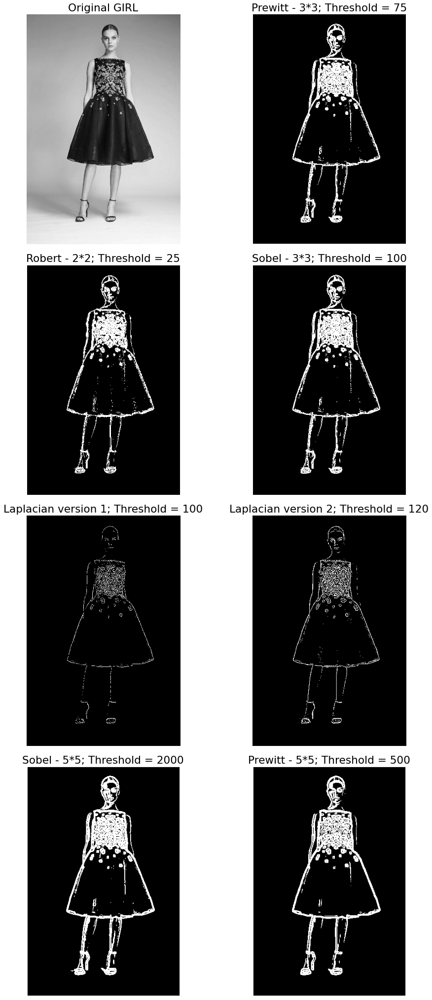

In [299]:
# Plot all Edge Detected Images...
mlp.rcParams.update({'font.size': 18})
edge_detected_imgs = [girl_gray, prewitt_edge_girl, robert_edge_girl, sobel_edge_girl, lapver1_girl, lapver2_girl,
                     sobel_edge5_girl, prewitt_edge5_girl]
edge_detected_imgs_titles = ["Original GIRL",
                            "Prewitt - 3*3; Threshold = 75",
                            "Robert - 2*2; Threshold = 25",
                            "Sobel - 3*3; Threshold = 100",
                            "Laplacian version 1; Threshold = 100",
                            "Laplacian version 2; Threshold = 120",
                            "Sobel - 5*5; Threshold = 2000",
                            "Prewitt - 5*5; Threshold = 500"]
plotter(4, 2, edge_detected_imgs, edge_detected_imgs_titles, mode = "GRAY",figsize = (15, 30), lim_enabled = False)

## Question 2.5 - Apply Edge Detection on Noisy Image

Zero-mean gaussian noise with $\sigma = 10$ and $\sigma = 30$ has been added to `girl.jpg` to obtain `girlNoisy1.jpg` and `girlNoisy2.jpg`, respectively. Study the effect of applying the above filters (from $2^{nd}$ Question) on the noise-affected inputs.

In [303]:
# Read the Noisy Girl Images...
girln1 = gray(cv2.imread("../images/girlNoisy1.jpg"))
girln2 = gray(cv2.imread("../images/girlNoisy2.jpg"))

In [302]:
# Define list for both girls to store the pre-processed images.
girln1_lst, girln2_lst = [], []

**For `girlNoisy1.jpg`**

In [304]:
# for 3*3 filters...
girln1_lst.append(combine_gradient_filter(girln1, prewitt_x, prewitt_y, 75))
girln1_lst.append(combine_gradient_filter(girln1, robert_x, robert_y, 25))
girln1_lst.append(combine_gradient_filter(girln1, sobel_x, sobel_y, 100))
# For laplacian...
girln1_lst.append(((np.clip(convolve2D(girln1, laplacian_ver_1), a_min = 0, a_max = 255) > lap1_thresh).astype(np.uint8))*255)
girln1_lst.append(((np.clip(convolve2D(girln1, laplacian_ver_2), a_min = 0, a_max = 255) > lap2_thresh).astype(np.uint8))*255)
# Compute Edges with these 5*5 filters...
girln1_lst.append(combine_gradient_filter(girln1, sobel_5x, sobel_5y, 2000))
girln1_lst.append(combine_gradient_filter(girln1, prewitt_5x, prewitt_5y, 500))

**Below IMAGES clearly illustrates that the `NOISES` too play a major role while EDGE detection. As these are `unwanted aberrations` in image where `intensity abruptly changes` and hence GRADIENT at those locations are high and it get higlighted as GRADIENT.**

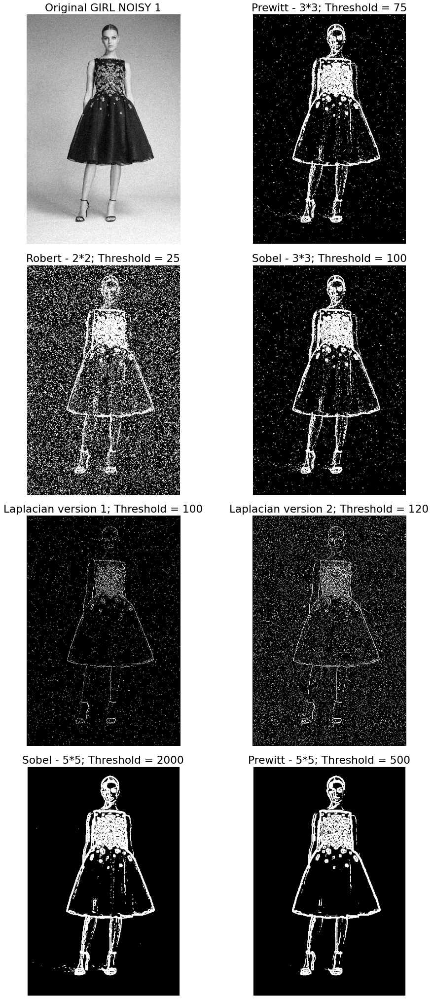

In [307]:
#Insert the noiys girl original image at Beginning.
girln1_lst.insert(0, girln1)
girln1_titles = ["Original GIRL NOISY 1",
                "Prewitt - 3*3; Threshold = 75",
                "Robert - 2*2; Threshold = 25",
                "Sobel - 3*3; Threshold = 100",
                "Laplacian version 1; Threshold = 100",
                "Laplacian version 2; Threshold = 120",
                "Sobel - 5*5; Threshold = 2000",
                "Prewitt - 5*5; Threshold = 500"]
plotter(4, 2, girln1_lst, girln1_titles, mode = "GRAY",figsize = (15, 30), lim_enabled = False)

**For `girlNoisy2.jpg`**

In [305]:
# for 3*3 filters...
girln2_lst.append(combine_gradient_filter(girln2, prewitt_x, prewitt_y, 75))
girln2_lst.append(combine_gradient_filter(girln2, robert_x, robert_y, 25))
girln2_lst.append(combine_gradient_filter(girln2, sobel_x, sobel_y, 100))
# For laplacian...
girln2_lst.append(((np.clip(convolve2D(girln2, laplacian_ver_1), a_min = 0, a_max = 255) > lap1_thresh).astype(np.uint8))*255)
girln2_lst.append(((np.clip(convolve2D(girln2, laplacian_ver_2), a_min = 0, a_max = 255) > lap2_thresh).astype(np.uint8))*255)
# Compute Edges with these 5*5 filters...
girln2_lst.append(combine_gradient_filter(girln2, sobel_5x, sobel_5y, 2000))
girln2_lst.append(combine_gradient_filter(girln2, prewitt_5x, prewitt_5y, 500))

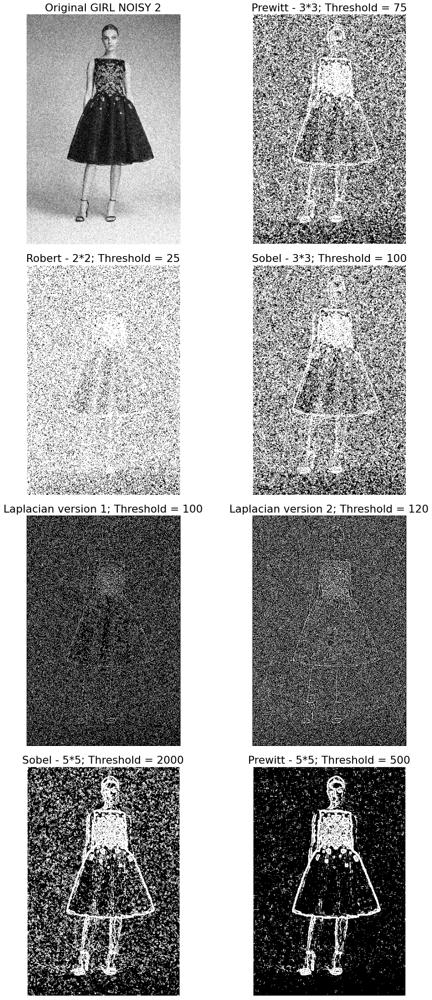

In [308]:
#Insert the noiys girl original image at Beginning.
girln2_lst.insert(0, girln2)
girln2_titles = ["Original GIRL NOISY 2",
                "Prewitt - 3*3; Threshold = 75",
                "Robert - 2*2; Threshold = 25",
                "Sobel - 3*3; Threshold = 100",
                "Laplacian version 1; Threshold = 100",
                "Laplacian version 2; Threshold = 120",
                "Sobel - 5*5; Threshold = 2000",
                "Prewitt - 5*5; Threshold = 500"]
plotter(4, 2, girln2_lst, girln2_titles, mode = "GRAY",figsize = (15, 30), lim_enabled = False)

# Question 3

**(30 points)** Gaussian Filtering and Bilateral Filtering

## Question 3.1 - Gaussian

Implement Gaussian filter and apply it to `mountain.png`. Vary $\sigma$ value for filter size, $5\times5$. Find the optimal $\sigma$ value for $k=5$ and compare the obtained outputs. Now vary the filter sizes (take optimal $\sigma$ value for each filter size) and report your observations along with the images.\
**Note:** Optimal filter size for a given σ is the one that snugly fits $99\%$ of the gaussian curve.

In [136]:
# Nearest odd.
def nearest_upper_odd(x, scale = 6):
    req_x = np.ceil(scale*x)
    if req_x % 2 != 0:
        return req_x
    return req_x + 1

def gauss2D(shape=(3,3), sigma = 1, method = "optimized"):
    """
    construct gaussian filter of given "shape" and "sigma" with given "method".
    if method == "optimized":
        automatically choose the optimal gaussian filter coefficients.
    else:
        go by "normal" strategy, for that put method = None
        
    Output:
        A Gaussian filter.
    """
    if method == "optimized":
        m,n = shape
        effective_range = nearest_upper_odd(sigma)
        # x-direction coefficients
        if n+2 < effective_range:
            x_samples = np.linspace(-3*sigma, 3*sigma, n+2)[1:-1]
        elif n <= effective_range < (n+2):
            x_samples = np.linspace(-3*sigma, 3*sigma, n)
        else:
            x_samples = np.linspace(-4*sigma, 4*sigma, n)
        # y-direction coefficients
        if m+2 < effective_range:
            y_samples = np.linspace(-3*sigma, 3*sigma, m+2)[1:-1]
        elif m <= effective_range < (m+2):
            y_samples = np.linspace(-3*sigma, 3*sigma, m)
        else:
            y_samples = np.linspace(-4*sigma, 4*sigma, m)
        #reshape both x and y.
        x_samples, y_samples = x_samples.reshape(1, -1), y_samples.reshape(-1, 1)
    elif method is None:
        m,n = [(ss-1)/2 for ss in shape]
        y_samples, x_samples = np.ogrid[-m:m+1,-n:n+1]
    else:
        raise ValueError("Oops! Enter correct method.")
    # Take the exponential i.e., to gaussian coefficients.
    h = np.exp(-(x_samples**2 + y_samples**2) / (2.*sigma**2))
    # Setting some limits.
    h[ h < np.finfo(h.dtype).eps*h.max() ] = 0
    # Normalize the matrix by dividing by its sum of elements.
    sumh = h.sum()
    if sumh != 0:
        h /= sumh
    return h

def gaussFiltering(image, kernel_shape=(3,3), sigma = 1, method = None):
    # generate gaussian filter...
    gauss_filter = gauss2D(shape=kernel_shape, sigma = sigma, method = method)
    if image.ndim == 2:
        # convolve gaussian-filter on image...
        return convolve2D(image, gauss_filter, padding="auto", strides=1)
    elif image.ndim == 3:
        output = []
        output.append(gaussFiltering(image[..., 0], kernel_shape = kernel_shape, sigma = sigma, method = method))
        output.append(gaussFiltering(image[..., 1], kernel_shape = kernel_shape, sigma = sigma, method = method))
        output.append(gaussFiltering(image[..., 2], kernel_shape = kernel_shape, sigma = sigma, method = method))
        return np.dstack(output)
    else:
        raise ValueError("Incorrect Image Format")

The shape of Mountain Image = (403, 571, 3)


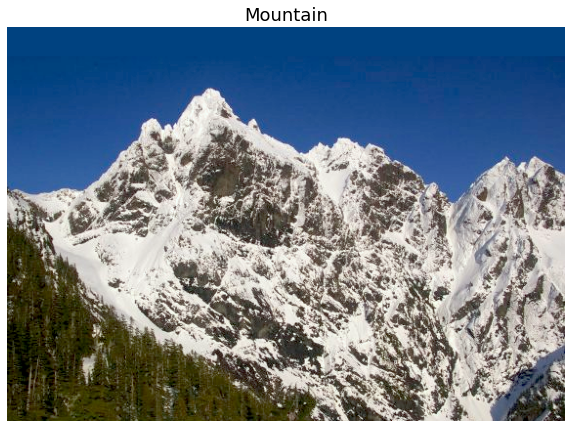

In [137]:
# Read mountain.png
mountain_im = cv2.imread("../images/mountain.png")
show_img(mountain_im, title="Mountain")

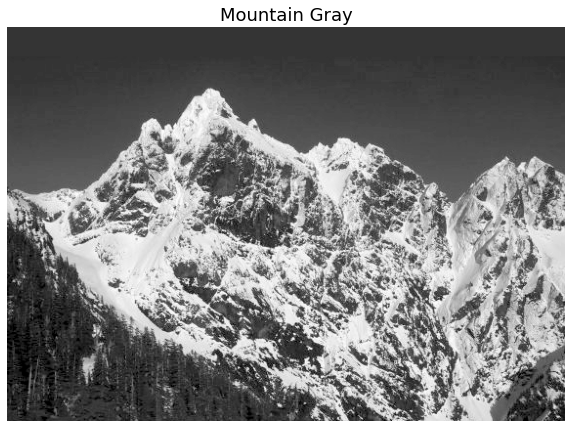

In [138]:
# Convert it to GRAYSCALE format.
mountain_gray = cv2.cvtColor(mountain_im, cv2.COLOR_BGR2GRAY)
show_img(mountain_gray, title="Mountain Gray", show_shape = False)

In [144]:
# define possible values for sigma.
sigmas = [0.25, 0.5, 0.8, 1,  1.5, 2]
sigma_varied_imgs = []
for sigma in sigmas:
    # convolve filter over image.
    filtered_img = gaussFiltering(mountain_im, kernel_shape=(5, 5), sigma = sigma, method = None)# (5-1)/2 = 2=padding
    # Append the images.
    sigma_varied_imgs.append(filtered_img.astype(np.uint8))

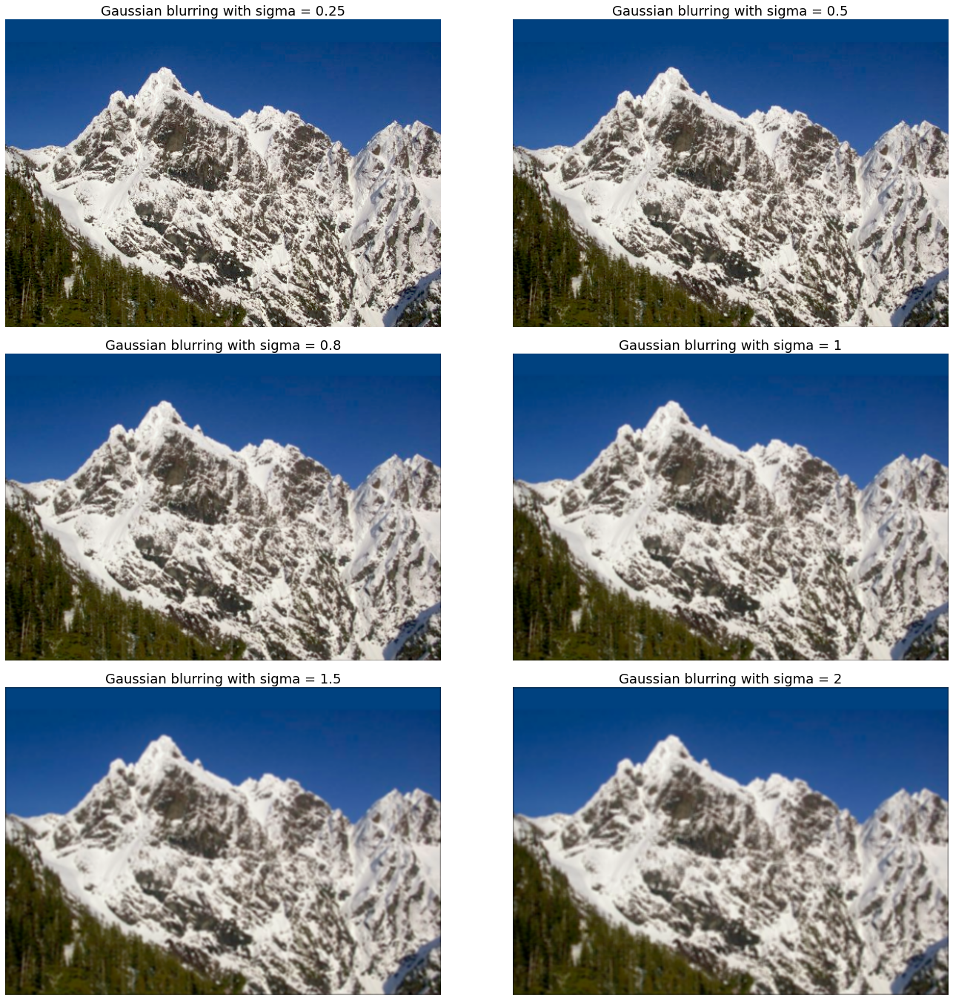

In [145]:
# Show all the images...
titles_lst = [f"Gaussian blurring with sigma = {sig}" for sig in sigmas]
plotter(3, 2, sigma_varied_imgs, titles_lst, mode = "RGB", figsize = (20, 20))

##### Optimal $\sigma = 0.8$

***Reasoning...***

1. As we increase $\sigma$, the gaussian curve gets more flatter (gradually tends to a `box` filter) and integral sampling of points around mean ($= \mu = 0$) are much more comparable (i.e., vary less) than in case for lower $\sigma$. Due to which the gaussian filter obtained, behaves more like a `box` filter that causes **extra smoothing**.
2. According to the properties of **Zero-Mean Gaussian** distribution, $[-3\sigma, 3\sigma]$ is the $\geq 99\%$ confidence interval. And following this formula above filter shape should be of size $= \lceil 6\sigma \rceil \times \lceil 6\sigma \rceil$, where $\lceil 6\sigma \rceil$ should be approximated to nearest upper odd integer as we require kernel of **odd** shape. Hence, for above problem with $K = 5$, we require $\sigma = 0.8$ to have an effective filter.
3. **Note that** if filter-shape $\ll \lceil 6\sigma \rceil$, then we would be getting a ultra-blurred image (as it resembles a `box` filter), while if filter-shape $\gg \lceil 6\sigma \rceil$ the blurring effect would be same as the filter with shape $= \lceil 6\sigma \rceil \times \lceil 6\sigma \rceil$ as more than $\lceil 6\sigma \rceil$ length our gaussian coefficients would be extremely small ($\approx 0$) and becomes constant.

In [146]:
# Vary filter sizes along with their corresponding optimal sigma value.
filter_sizes = [3, 5, 7, 9, 11, 13]
optimal_sigmas = [0.5, 0.9, 1.2, 1.5, 1.9, 2.2]
blurred_imgs = []
for filter_shape, sigma in zip(filter_sizes, optimal_sigmas):
    # convolve gaussian filter over image.
    filtered_img = gaussFiltering(mountain_im, kernel_shape=(filter_shape, filter_shape), sigma = sigma, method = None)# (5-1)/2 = 2=padding
    # Append the images.
    blurred_imgs.append(filtered_img.astype(np.uint8))

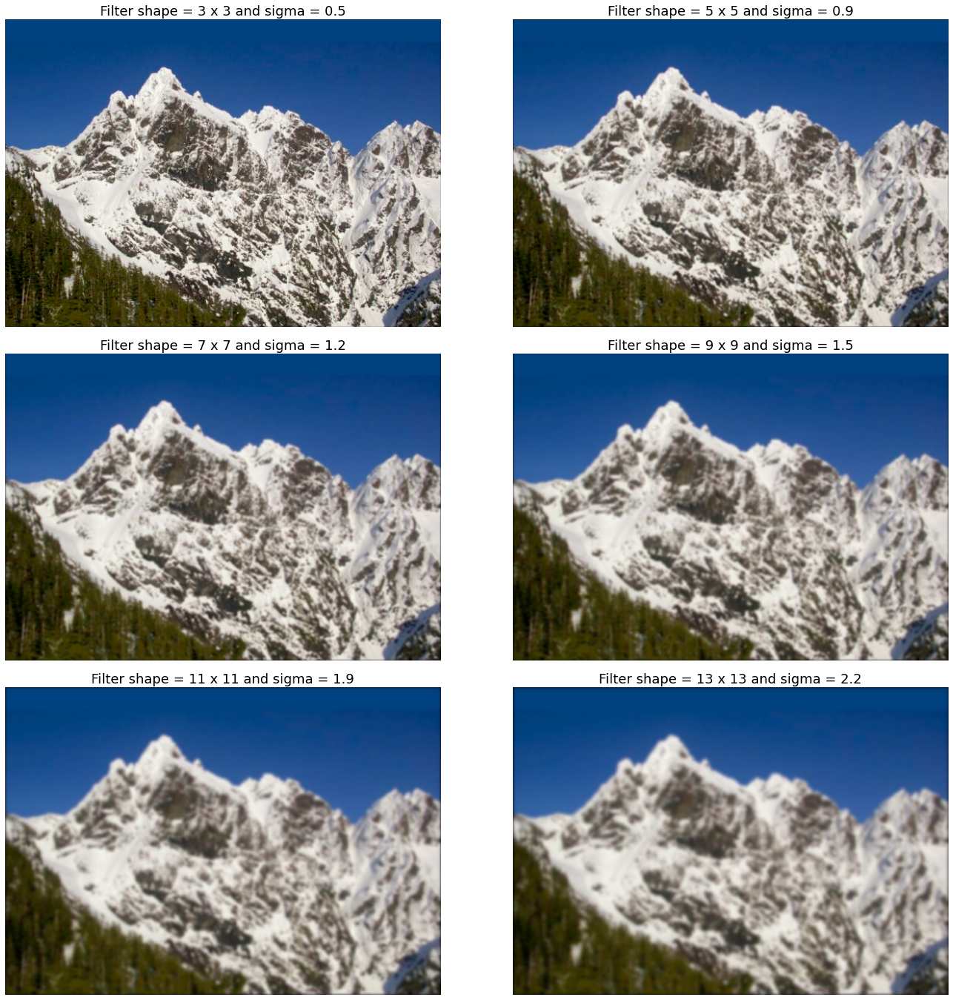

In [147]:
# Show all the images...
titles_lst = [f"Filter shape = {filter_size} x {filter_size} and sigma = {optimal_sigma}" for filter_size, optimal_sigma in zip(filter_sizes, optimal_sigmas)]
plotter(3, 2, blurred_imgs, titles_lst, mode = "RGB", figsize = (20, 20))

***Observations...***

We get such effect due to the window sizes of kernel. Larger is the window size with larger $\sigma$, the slower the coefficient varies as we move away from central element of kernel. As a result of which it has more of `box` filter like characteristics i.e., giving considerable weight to neighboring pixels and take their values into account while filtering.

## Question 3.2 - Bilateral Filter

Implement bilateral filtering and apply it to mountain.png.

https://machinelearningknowledge.ai/bilateral-filtering-in-python-opencv-with-cv2-bilateralfilter/

__We're not using our `convolve2D()` function as here Kernel is not fixed. With change in co-ordinates of the image, the kernel coefficients change too.__

In [149]:
# Domain Kernel -- that denoise image.
def domainKernel(i, j, k, l, sigma): return np.exp(- (((i-k)**2) + ((j-l)**2)) / (2*(sigma**2)) )
# Range Kernel -- that helps in preserving edges.
def rangeKernel(f_ij, f_kl, sigma): return np.exp(-((f_ij-f_kl)**2) / (2*(sigma**2)))
# Function to return Bilateral filtered image.
def bilateral(image, kernel_shape, sigma_d, sigma_r):
    """
    image: given image to filter, k = 
    """
    output = np.zeros([image.shape[0], image.shape[1]])
    p = kernel_shape//2
    # Padding the image according to the kernel size.
    pad_image = np.zeros((image.shape[0] + (2*p), image.shape[1] + (2*p)))  
    pad_image[p:-p, p:-p] = image
    # traversing through whole image.
    for i in range(p, pad_image.shape[0]-p):
        for j in range(p, pad_image.shape[1]-p):
            # Concerned pixel - i,j th pixel
            f_ij = pad_image[i,j]
            # To take sum of product of image-pixels and weight
            filtered_pixel = 0
            #To take sum of weights for normalization.
            weights = 0
            for k in range(i-p, i+p+1):
                for l in range(j-p, j+p+1):
                    # k,l th pixel of image.
                    f_kl = pad_image[k,l]
                    # Computing gaussian distance for pixel (k, l) from (i,j)
                    d = domainKernel(i, j, k, l, sigma_d)
                    # Computing gaussian distance for pixel intensty of (k, l) from (i,j)
                    r = rangeKernel(f_ij, f_kl, sigma_r)
                    # Bilateral weight
                    w = d*r
                    # Numerator of g(i, j)
                    filtered_pixel += (pad_image[k, l] * w)
                    # Denominator of g(i, j) -- normalization
                    weights += w
            # Storing the pixel value for corresponding location in output image.
            output[i-p, j-p] = np.clip((filtered_pixel / weights), 0, 255).astype(np.uint8)
    return output

def bilateralFiltering(image, kernel_size, sigma_d, sigma_r):
    """
    This function Handles the dimensionality of Image.
    """
    if (image.ndim == 2):
        filtered_image = bilateral(image, kernel_size, sigma_d, sigma_r)
    elif (image.ndim == 3):
        filtered_image = np.empty_like(image)
        filtered_image[..., 0] = bilateral(image[:,:,0], kernel_size, sigma_d, sigma_r)
        filtered_image[..., 1] = bilateral(image[:,:,1], kernel_size, sigma_d, sigma_r)
        filtered_image[..., 2] = bilateral(image[:,:,2], kernel_size, sigma_d, sigma_r)
            
    return filtered_image


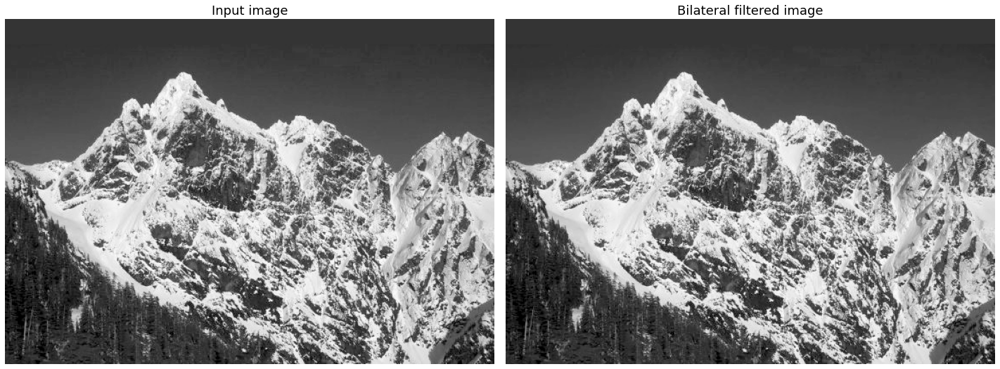

In [155]:
filtered_image = bilateralFiltering(mountain_gray, 5, 80, 1)

images = [mountain_gray, filtered_image]
titles = ['Input image', 'Bilateral filtered image']
    
plotter(1, 2, images, titles, mode = "GRAY")

## Question 3.3 - Vary effect of Domain and Range

Vary the effect of domain and range components of the bilateral filter and report your observations along with the images.

In [156]:
# different set of Spatial_sigma and Range_Sigma.
sigma_d = [10, 25, 50, 100, 200]
sigma_d = sigma_d + sigma_d[::-1]
sigma_r = [0.1, 0.5, 1, 2, 5]
sigma_r = sigma_r + sigma_r
# run the loop to obtain filtered images.
binary_filtered_imgs = []
for d, r in zip(sigma_d, sigma_r):
    binary_filtered_imgs.append(bilateralFiltering(mountain_gray, 5, d, r))

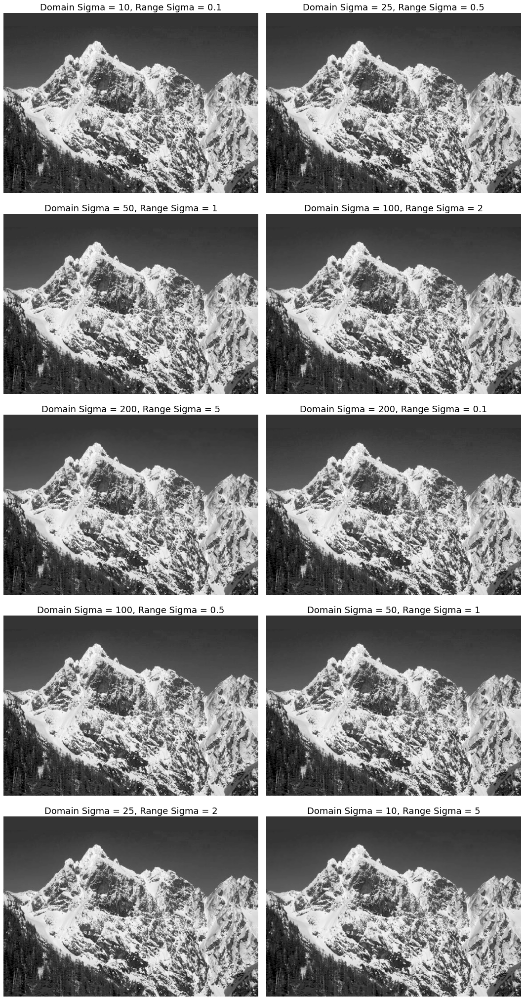

In [157]:
# Plot BInary Filtered Images...
titles_lst = [f"Domain Sigma = {sig_d}, Range Sigma = {sig_r}" for sig_d, sig_r in zip(sigma_d, sigma_r)]
plotter(5, 2, binary_filtered_imgs, titles_lst, mode = "GRAY", figsize = (15, 30))

##### Resources on Bilateral Filter...

https://dsp.stackexchange.com/questions/61988/understanding-the-bilateral-filter-neighbors-and-sigma

https://dsp.stackexchange.com/questions/6289/understanding-the-parameters-of-the-bilateral-filter

https://en.wikipedia.org/wiki/Bilateral_filter#Parameters

# Question 4

**(20 points) Rain removal**

In rainy days, the performance of outdoor vision systems will significantly degrade due to visibility obstruction, deformation, and blurring caused by raindrops. Therefore, it is highly desirable to remove raindrops from rainy images to ensure the reliability of outdoor vision systems.

**Note:** This question has to be done on RGB images only. But you can work on each channel separately, and then combine them for final image.

The shape of Rain Image = (248, 371, 3)


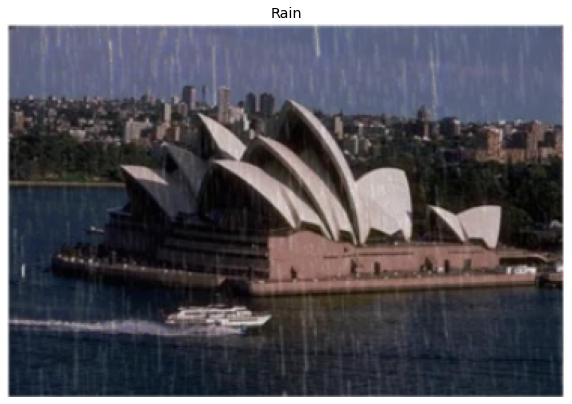

In [79]:
#read the rain image...
rain_im = cv2.imread("../images/rain.png")
show_img(rain_im, title = "Rain")

## Question 4.1 - Gaussian on `rain.png`

Apply gaussian filter on `rain.png`. Report the $\sigma$ value and filter size for the best output.

In [80]:
#Let's apply the gaussian filter...with some sigma, and shape = (5, 5)
# Obtain the gaussian filter.
sigma, shape = 1.2, 5
gauss_filter = gauss2D(shape=(shape, shape), sigma = sigma, method = "optimized")
# Define an empty array.
filtered_img = np.empty_like(rain_im)
# convolve filter over image.
filtered_img[..., 0] = convolve2D(rain_im[...,0], gauss_filter, padding=2, strides=1)# (5-1)/2 = 2=padding
filtered_img[..., 1] = convolve2D(rain_im[...,1], gauss_filter, padding=2, strides=1)
filtered_img[..., 2] = convolve2D(rain_im[...,2], gauss_filter, padding=2, strides=1)

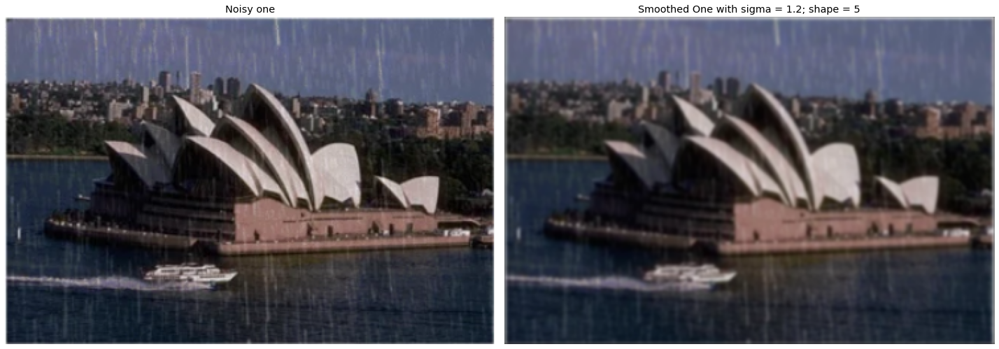

In [81]:
# Show the filtered image.
plotter(1, 2, [rain_im, filtered_img], ["Noisy one", f"Smoothed One with sigma = {sigma}; shape = {shape}"])

**So far, after trying out several values we got the best parameter as $\sigma$ $= 1.2$ with shape $= 5\times 5$.**

**NOTE: "BEST" is defined according to the user speculation.**

## Question 4.2 - Median on `rain.png`

Apply median filter on `rain.png`. Report the filter size for the best output.

In [211]:
# Define median filter to remove salt and pepper noise.
def medianFilter(image, kernel_shape):
    # For grayscale images i.e. 2D images.
    if image.ndim == 2:
        # Create an empty output array
        output = np.empty_like(image)
        #padding value
        p = kernel_shape//2
        #Zero Padding the image
        pad_img = np.zeros((image.shape[0] + (p+1), image.shape[1] + (p+1)))
        pad_img[p:-1,p:-1] = image
        #Applying median filter.
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                output[i,j] = np.median(pad_img[i:i+k,j:j+k])
        return output.astype(np.uint8)
    elif image.ndim == 3: # For 3D Images...
        # Create an empty output array
        output = np.empty_like(image)
        # Apply recursion for 3D images
        output[..., 0] = medianFilter(image[..., 0], kernel_shape)
        output[..., 1] = medianFilter(image[..., 1], kernel_shape)
        output[..., 2] = medianFilter(image[..., 2], kernel_shape)
        return output
    else:
        raise ValueError("Check your Image dimensions...")

In [171]:
# define the kernel shapes
kernel_size = [3, 5, 7, 9]
median_filtered_images = []
titles_lst_median = []
# Append the original image and its name.
median_filtered_images.append(rain_im)
titles_lst_median.append('Original Image of Rain')
# Run through loop to look the results...
for i in kernel_size:
    median_filtered_images.append(medianFilter(rain_im, i))
    titles_lst_median.append('Filtered with k = {}'.format(i))

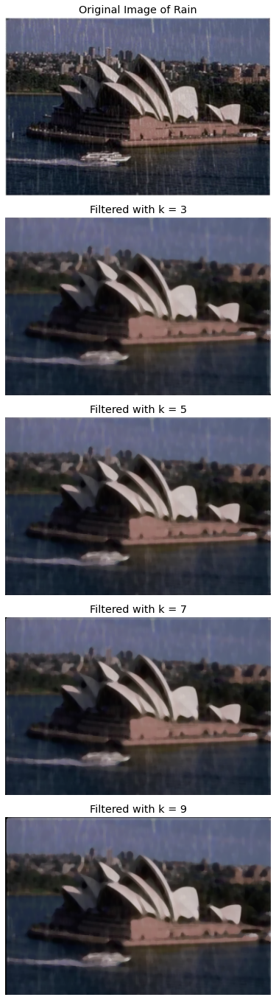

In [179]:
# Show the images...
mlp.rcParams.update({'font.size': 15})
plotter(5, 1, median_filtered_images, titles_lst_median)

## Question 4.3 - Bilateral on `rain.png`

Apply bilateral filter on `rain.png`. Report the $\sigma$ values (domain and range components) and filter size for the best output.

In [42]:
# different set of Spatial_sigma and Range_Sigma.
sigma_d = [50, 100, 200, 500]
sigma_d = sigma_d + sigma_d[::-1]
sigma_r = [0.1, 0.25, 0.5, 1]
sigma_r = sigma_r + sigma_r
# run the loop to obtain filtered images.
binary_fil_rgb_imgs = []
for d, r in zip(sigma_d, sigma_r):
    binary_fil_rgb_imgs.append(bilateralFiltering(rain_im, 5, d, r))

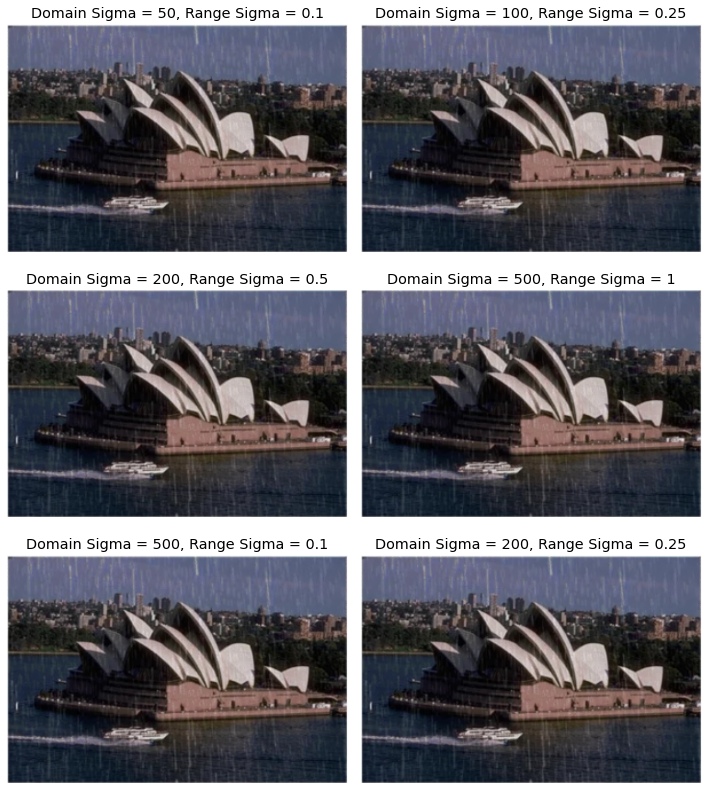

In [43]:
# Plot BInary Filtered Images...
mlp.rcParams.update({'font.size': 12})
titles_lst = [f"Domain Sigma = {sig_d}, Range Sigma = {sig_r}" for sig_d, sig_r in zip(sigma_d, sigma_r)]
plotter(3, 2, binary_fil_rgb_imgs, titles_lst, mode = "RGB", figsize = (10, 12))

## Question 4.4 - Compare outputs of 3 filters

Compare the outputs from the above three filters and report your observations. Feel free to try out any other methods to achieve the intended result.

**Note:** The best output is one where the rain drops are minimally visible without affecting the rest of the scene or introducing new artifacts into the scene.

**ANSWER:**

After trying out `ALL` the above `3 filters` on the `rain.jpg` we get into this conclusion that `MEDIAN` filter performs the best among all, from which filter with shape $5 \times 5$ performed the best.

# Question 5

**(30 points) Cartoon Creation**

In order to achieve a basic cartoon effect, all you need is essentially - a `bilateral filter` and some `edge detection`. The bilateral filter will reduce the color palette,necessary for the cartoon look, and edge detection will allow production of bold silhouettes. To get cartoonized effects following steps are needed:

## Question 5.1 - Apply Bilateral on Color

Apply the bilateral filtering to the color image. Keep this filtered image aside for the last step.

In [100]:
# We will apply the Bilateral Filter on cup.png.
cup_smoothed = bilateralFiltering(cup_im, 9, 400, 50)

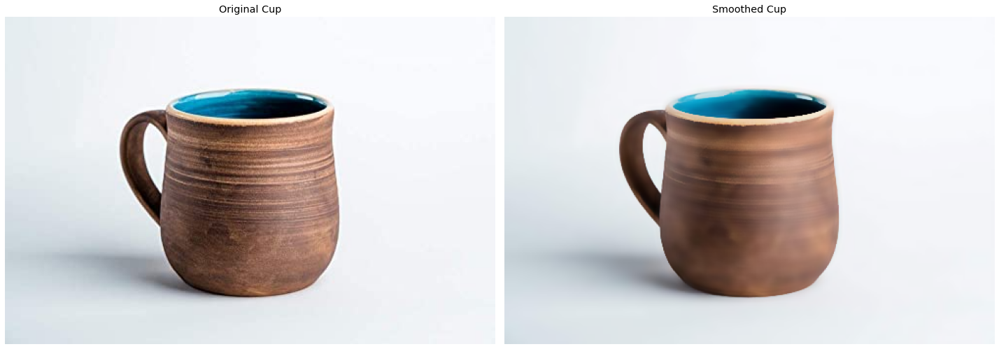

In [101]:
# Display the smoothed image...
#show_img(cup_smoothed, title = "Bilaterally Smoothed Cup", show_shape = False)
plotter(1, 2, [cup_im, cup_smoothed], ["Original Cup", "Smoothed Cup"])

## Question 5.2 - Smoothing the Gray

Now, take a copy of original color image, convert it to gray scale.

Apply blurring on this gray scale image to reduce noise. \[You can try different variants of blurring(box filter, gaussian filter, repeated gaussian filter,..) with different filter sizes and see the performance\]

In [104]:
# Take the gray scale version and apply blurring by using Repeated Gaussian Filters (2 times)...
# Obtain the gaussian filter.
gauss_filter = gauss2D(shape=(3, 3), sigma = 1.2, method = None)
# convolve filter over image.
gray_cup_smoothed = convolve2D(convolve2D(cup_gray, gauss_filter, padding=1), gauss_filter, padding=1)

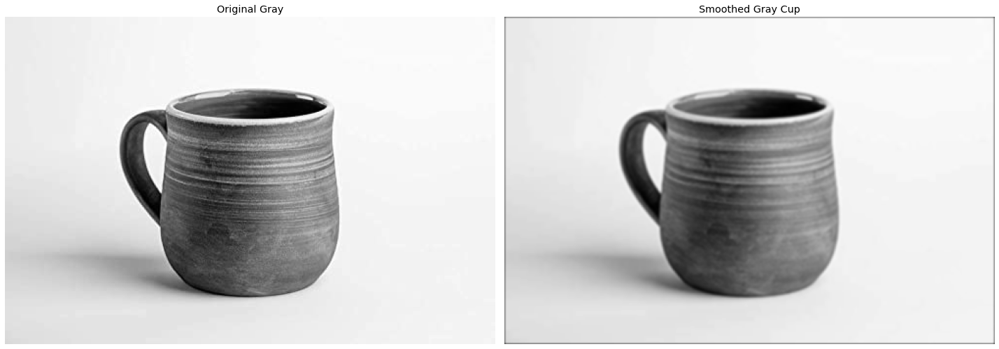

In [105]:
# Display the smoothed Gray-Scale image
#show_img(gray_cup_smoothed, title = "Repeated Gaussian Smoothed Cup", show_shape = False, mode = "GRAY")
plotter(1, 2, [cup_gray, gray_cup_smoothed], ["Original Gray", "Smoothed Gray Cup"], mode = "GRAY")

## Question 5.3 - Compute Edges of Smooth-Gray

Now, create an edge mask from this blurred, gray scale image. An edge mask can be obtained using adaptive thresholding.\
(Links for reading about adaptive thresholding : [link1](https://www.tutorialspoint.com/opencv/opencv_adaptive_threshold.htm) and [link2](https://docs.opencv.org/4.5.3/d7/d1b/group__imgproc__misc.html))\
\[You can also try obtaining the edge mask by pixel wise division of the grayscale image by the blurred image (of the edges) to generate an outline similar to pencil sketches.\]

https://www.geeksforgeeks.org/python-thresholding-techniques-using-opencv-set-2-adaptive-thresholding/

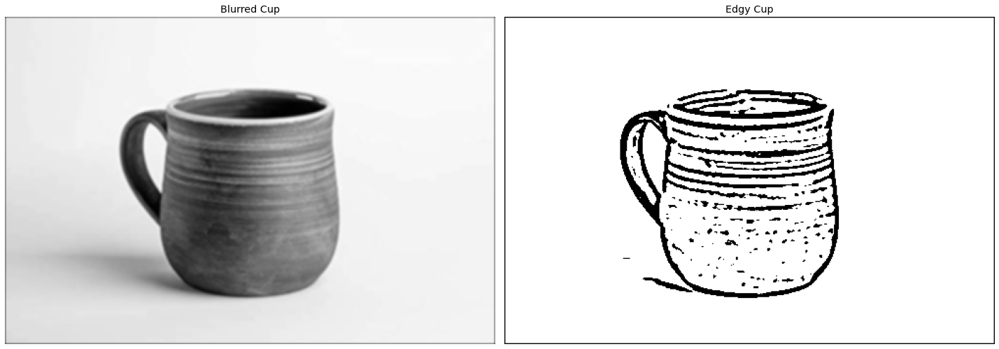

In [106]:
thresholded_image = cv2.adaptiveThreshold(gray_cup_smoothed, 255, 
                                          cv2.ADAPTIVE_THRESH_MEAN_C, 
                                          cv2.THRESH_BINARY, 
                                          11, 7)
plotter(1, 2, [gray_cup_smoothed, thresholded_image], ["Blurred Cup", "Edgy Cup"], mode = "GRAY")

## Question 5.4 - Apply Bitwise AND

Combine the bilateral filtered image from `Step 1` with edge mask (by taking `bitwise AND` of both at each pixel location).

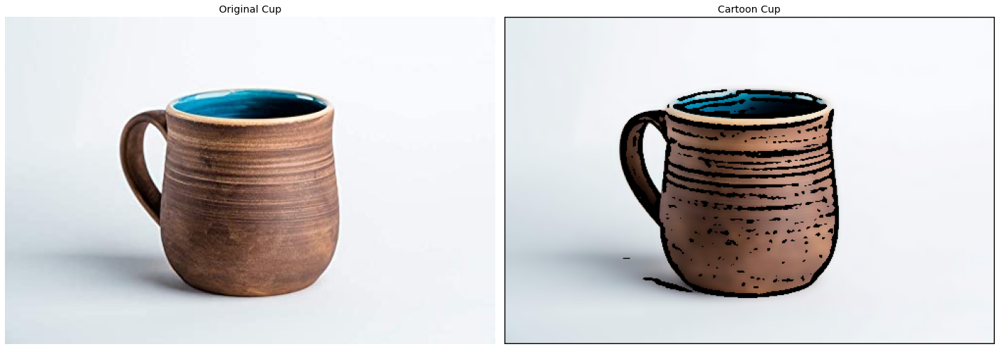

In [120]:
# Apply bitwise AND to obtain cartoonish effect.
cartoon_image = np.empty_like(cup_smoothed)
cartoon_image[..., 0] = np.bitwise_and(cup_smoothed[..., 0], thresholded_image)
cartoon_image[..., 1] = np.bitwise_and(cup_smoothed[..., 1], thresholded_image)
cartoon_image[..., 2] = np.bitwise_and(cup_smoothed[..., 2], thresholded_image)
# Show both Images.
plotter(1, 2, [cup_im, cartoon_image], ["Original Cup", "Cartoon Cup"])

**Now try to do these for images of your choice.**\
Feel free to experiment with different filters and even methods to generate even better cartoons.\
**Note:** This question has to be done on RGB images only.

The shape of BUS Image = (511, 640, 3)


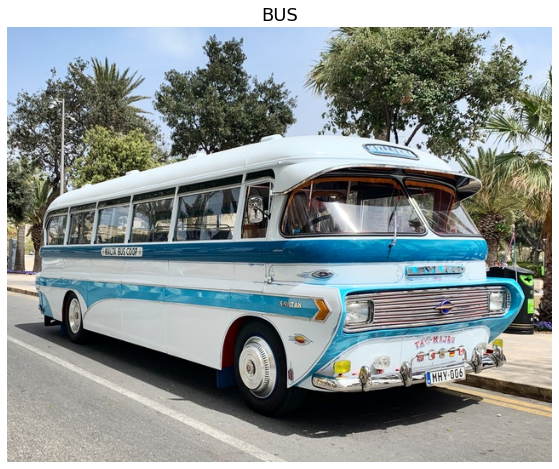

In [159]:
# read The BUS Image
bus = cv2.imread("../images/bus.jpg")
show_img(bus, title = "BUS")

In [160]:
# We will apply the Bilateral Filter on cup.png.
bus_smoothed = bilateralFiltering(bus, 9, 400, 50)

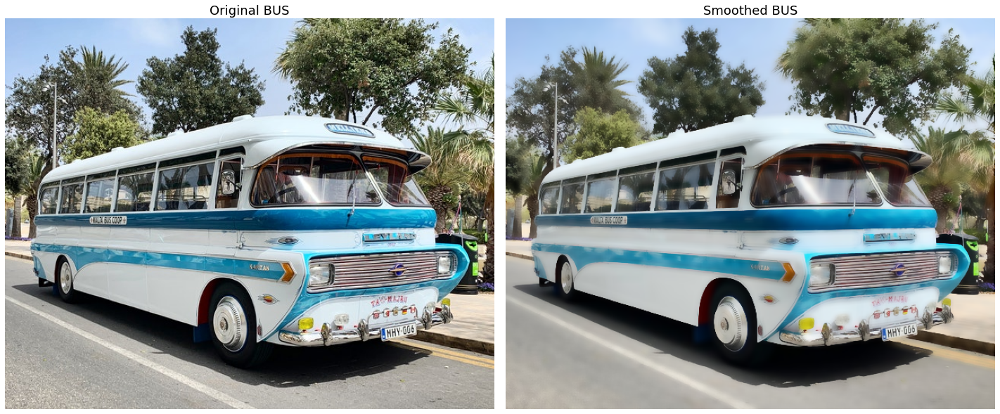

In [161]:
# Display the smoothed image...
plotter(1, 2, [bus, bus_smoothed], ["Original BUS", "Smoothed BUS"])

In [162]:
# Take the gray scale version and apply blurring by using Repeated Gaussian Filters (2 times)...
bus_gray = gray(bus)
# convolve filter over image.
gray_bus_smoothed1 = gaussFiltering(bus_gray, kernel_shape=(5, 5), sigma = 1.2, method = None)
gray_bus_smoothed = gaussFiltering(gray_bus_smoothed1, kernel_shape=(5, 5), sigma = 1.2, method = None)

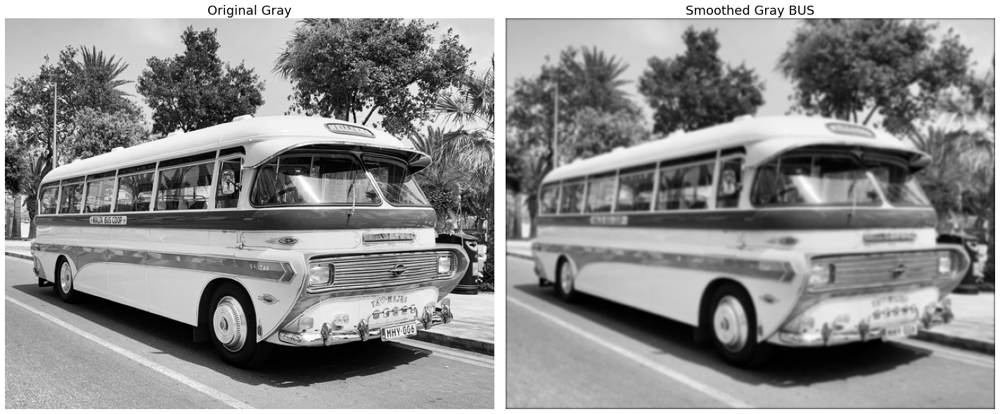

In [163]:
# Display the smoothed Gray-Scale image
plotter(1, 2, [bus_gray, gray_bus_smoothed], ["Original Gray", "Smoothed Gray BUS"], mode = "GRAY")

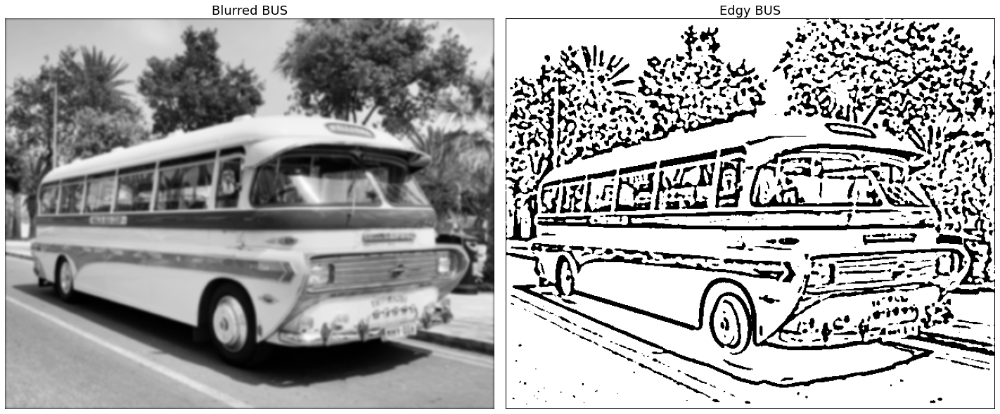

In [167]:
thresholded_image_bus = cv2.adaptiveThreshold(gray_bus_smoothed.astype(np.uint8), 255, 
                                          cv2.ADAPTIVE_THRESH_MEAN_C, 
                                          cv2.THRESH_BINARY, 
                                          11, 7)
plotter(1, 2, [gray_bus_smoothed, thresholded_image_bus], ["Blurred BUS", "Edgy BUS"], mode = "GRAY")

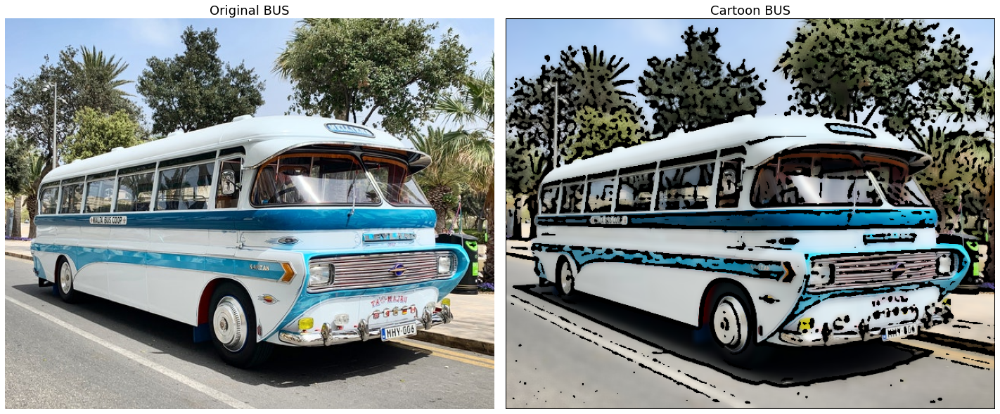

In [168]:
# Apply bitwise AND to obtain cartoonish effect.
cartoon_image_bus = np.empty_like(bus_smoothed)
cartoon_image_bus[..., 0] = np.bitwise_and(bus_smoothed[..., 0], thresholded_image_bus)
cartoon_image_bus[..., 1] = np.bitwise_and(bus_smoothed[..., 1], thresholded_image_bus)
cartoon_image_bus[..., 2] = np.bitwise_and(bus_smoothed[..., 2], thresholded_image_bus)
# Show both Images.
plotter(1, 2, [bus, cartoon_image_bus], ["Original BUS", "Cartoon BUS"])

# Question 6

**(15 points) Unsharp Masking and Highboost filtering**

###### Sources...

https://www.geeksforgeeks.org/addition-blending-images-using-opencv-python/

https://homepages.inf.ed.ac.uk/rbf/HIPR2/unsharp.htm

https://www.idtools.com.au/unsharp-masking-with-python-and-opencv/

In [12]:
# Define Unsharp Masking...
def unsharp_mask(image, kernel_size=(5, 5), sigma=1.0, amount=1.0, threshold=0):
    """Return a sharpened version of the image, using an unsharp mask."""
    if image.ndim == 2:
        # Blur the Image using Gaussian filter.
        blurred = gaussFiltering(image, kernel_shape = kernel_size, sigma = sigma, method = None)
        #blurred = cv.GaussianBlur(image, kernel_size, sigma)
        # Sharpen the image...
        sharpened = float(amount + 1) * image - float(amount) * blurred
        # Convert negative pixels to 0.
        sharpened = np.maximum(sharpened, np.zeros(sharpened.shape))
        # Convert pixel values above 255 to 255.
        sharpened = np.minimum(sharpened, 255 * np.ones(sharpened.shape))
        # Convert float values to 8-bit type, if any.
        sharpened = sharpened.astype(np.uint8)#round()
        # Create mask of 0 and 1, and paste the image content to sharpened one where no edges are there.
        if threshold > 0:
            low_contrast_mask = np.absolute(image - blurred) < threshold
            # where zeros in mask at that place put image into sharpened.
            np.copyto(sharpened, image, where=low_contrast_mask)
        return sharpened
    elif image.ndim == 3: # for 3-dimensional images...
        sharpened = np.empty_like(image)
        sharpened[..., 0] = unsharp_mask(image[..., 0], kernel_size = kernel_size, sigma = sigma, 
                                         amount = amount, threshold=threshold)
        sharpened[..., 1] = unsharp_mask(image[..., 1], kernel_size = kernel_size, sigma = sigma, 
                                         amount = amount, threshold=threshold)
        sharpened[..., 2] = unsharp_mask(image[..., 2], kernel_size = kernel_size, sigma = sigma, 
                                         amount = amount, threshold=threshold)
        return sharpened

## Question 6.1 - Unsharp Masking

Implement `Unsharp Masking` and apply it to `orion.jpg`.

The shape of Orion Image = (480, 600, 3)


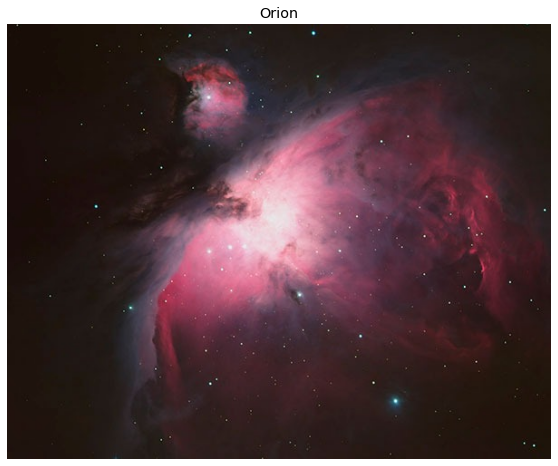

In [119]:
# Read orion.jpg
orion_im = cv2.imread("../images/orion.jpg")
show_img(orion_im, title = "Orion")

In [138]:
# Apply unsharp masking to gray orion.jpg
orion_gray = cv2.cvtColor(orion_im, cv2.COLOR_BGR2GRAY)
sharp_orion_gray = unsharp_mask(orion_gray, kernel_size = (5, 5), sigma=1.0, threshold = 4)#, amount=1.0, threshold=0
sharp_orion_color = unsharp_mask(orion_im, kernel_size = (5, 5), sigma=1.0, threshold = 4)

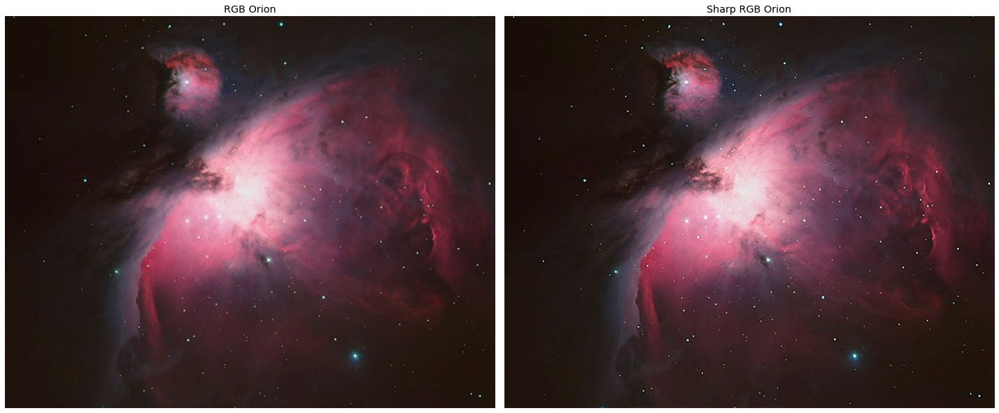

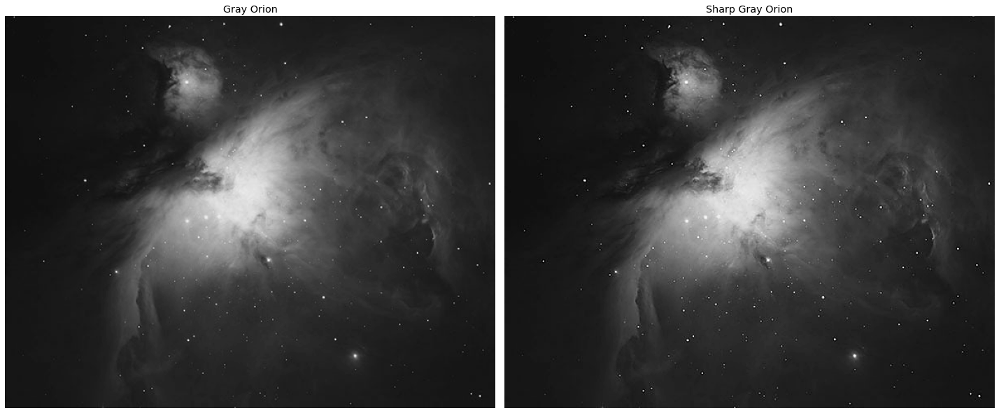

In [139]:
# Show the images...
plotter(1, 2, [orion_im, sharp_orion_color], ["RGB Orion", "Sharp RGB Orion"])
plotter(1, 2, [orion_gray, sharp_orion_gray], ["Gray Orion", "Sharp Gray Orion"], mode = "GRAY")

## Question 6.2 - Highboost Filtering

Implement `Highboost Filtering` and apply it to `orion.jpg`. Increase the coefficient values for the edge mask and report your observations.\
(Take the same filter size as in unsharp Masking.)

In [148]:
# Apply unsharp masking to gray orion.jpg
orion_gray = cv2.cvtColor(orion_im, cv2.COLOR_BGR2GRAY)
highboost_orion_gray = unsharp_mask(orion_gray, kernel_size = (5, 5), sigma=1.0, amount=5.0, threshold=4)#, amount=1.0, threshold=0
highboost_orion_color = unsharp_mask(orion_im, kernel_size = (5, 5), sigma=1.0, amount=5.0, threshold=4)

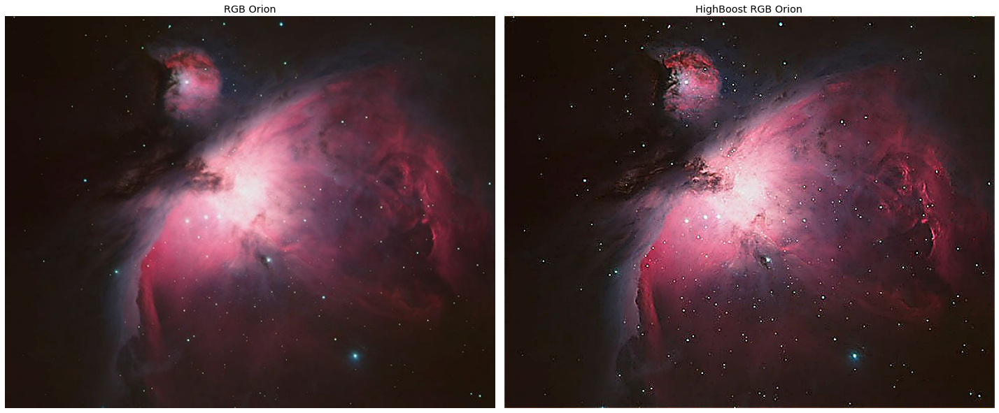

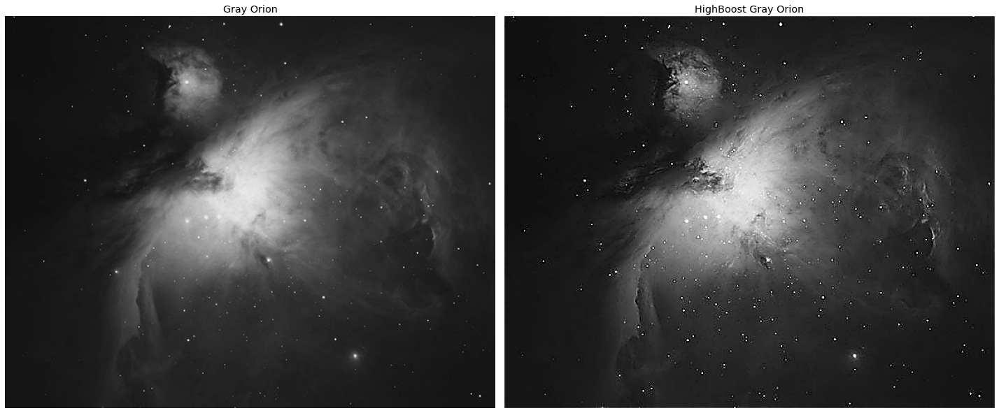

In [149]:
# Show the images...
plotter(1, 2, [orion_im, highboost_orion_color], ["RGB Orion", "HighBoost RGB Orion"])
plotter(1, 2, [orion_gray, highboost_orion_gray], ["Gray Orion", "HighBoost Gray Orion"], mode = "GRAY")

## Question 6.3 - Compare two different methods.

Choose any **three** different filter sizes. Compare the __two methods__ for each filter size and report your observations along with the images.

In [151]:
# List for filter shapes.
sharp_filter_lst = [(5, 5), (7, 7), (9, 9)]
sharp_lst = []
for filter_ in sharp_filter_lst:
    sharp_lst.append(unsharp_mask(orion_gray, kernel_size = filter_, sigma=1.3, threshold = 4))
    sharp_lst.append(unsharp_mask(orion_gray, kernel_size = filter_, sigma=1.3, amount = 5.0, threshold = 4))

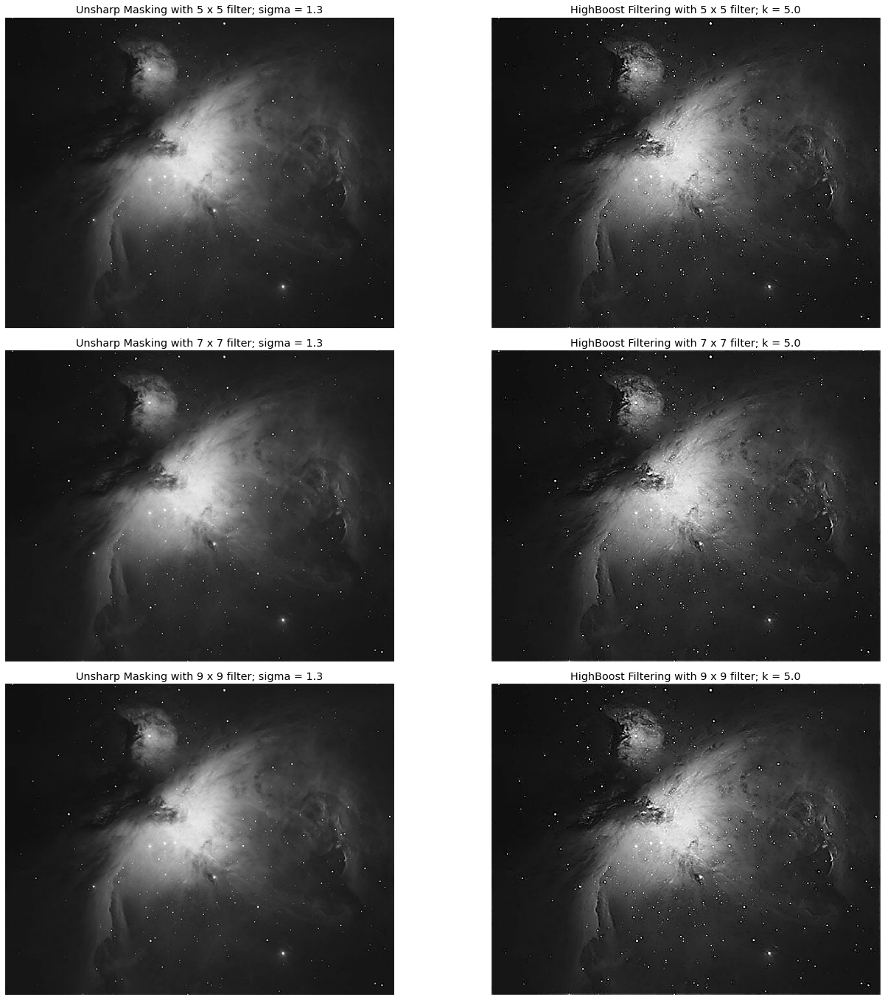

In [152]:
# Plot the images...
sharp_lst_titles = [[f"Unsharp Masking with {shape[0]} x {shape[1]} filter; sigma = {1.3}", 
                     f"HighBoost Filtering with {shape[0]} x {shape[1]} filter; k = 5.0"] 
                    for shape in sharp_filter_lst]
new_lst = []
for k, j in sharp_lst_titles:
    new_lst.append(k)
    new_lst.append(j)
    
plotter(3, 2, sharp_lst, new_lst, mode = "GRAY")

# Question 7

**(40 points) Fourier Transform**

## Question 7.1 - 2D DFT

Implement `2D DFT`.

In [171]:
def DFT2D(image):
    """Implement 2D DFT on the image."""
    data = np.asarray(image)
    a, b = image.shape# rows_len = y-cord; col_len = x-cord
    dft_im = np.zeros((a,b),dtype=complex)
    for m in range(b):
        for n in range(a):
            sum_p = 0.0
            for p in range(b):
                for q in range(a):
                    # Exponential part to be multiplied with pixel at position (p, q)
                    e = np.exp(-1 * 2j * np.pi * ((m * p) / a + (n * q) / b))
                    sum_p +=  data[p,q] * e
            dft_im[m,n] = sum_p
    return dft_im

def shift_dft(f):
    """FFT Shift the fourier Transformed Image."""
    n = f.shape[0]
    y = np.asarray(f)  # copy
    # To see its action see rough section.
    y = np.roll(f, n//2, axis=[0,1])
    return y

## Question 7.2 - 1D FFT & 2D FFT

Implement `1D FFT`. Use it to implement `2D FFT` and display the result on suitable images of your choice.\
__Compare the runtimes__ of your version of DFT and FFT on different sized images (as in **Q1**) and plot them.

In [172]:
# define recursive One-Dimensional FFT.
def rec_fft(n, x):
    """Recursively compute FFT (basically a DFT of order n*log(n)); Note that 'n' should be POWER of 2."""
    # Convert the input to numpy array and  Convert it to one dimensional array.
    x = np.asarray(x, dtype=complex).ravel()
    # base condition...
    if n == 1:
        return x[0]
    else:
        # even component...taking even index elements.
        f_even = rec_fft(n//2, x[0::2])
        # odd component...taking odd index elements.
        f_odd = rec_fft(n//2, x[1::2])
        # combine DFTs of two halves into full DFT:
        
        #output = np.zeros_like(x)
        #for k in range(n//2):
        #    w_k = np.exp(-2j * np.pi * k / n)
        #    if type(f_even) == np.ndarray:
        #        y_k = f_even[k] + w_k*f_odd[k]
        #    else:
        #        y_k = f_even + w_k*f_odd
        #    output[k] = y_k
        #    if type(f_odd) == np.ndarray:
        #        y_k_n2 = f_even[k] - w_k*f_odd[k]
        #    else:
        #        y_k_n2 = f_even - w_k*f_odd
        #    output[k + (n//2)] = y_k_n2
        # ABOVE CODE Condensed to below.
        terms = np.exp((-2j * np.pi * np.arange(n)) / n)
        return np.concatenate([f_even + terms[:(n//2)] * f_odd, f_even + terms[(n//2):] * f_odd])

# Iterative version of One Dimensional FFT.
def iter_fft(x):
    """Vectorized & iterative FFT (basically a DFT of order n*log(n)); Note that 'n' should be POWER of 2."""
    # Convert the input to numpy array and  Convert it to one dimensional array.
    x = np.asarray(x, dtype=complex)
    N = len(x)
    temp = x.reshape((1, N))
    # Run through loop...
    while temp.shape[0] < N:
        m, n = temp.shape
        odd, even = temp[:, n // 2:], temp[:, :n // 2]
        coff = np.exp(-1j * np.pi * np.arange(m) / m)[:, None]
        temp = np.vstack((even + coff * odd, even - coff * odd))

    return temp.ravel()

# Apply Recursive or Iterative FFT to 2D data...
def get_2d(data, mode = "recursive"):
    """Apply `fft` to each row, then to each column."""
    result = np.copy(data)
    if mode == "recursive":
        result = np.array([rec_fft(len(row), row) for row in result])
        result = np.array([rec_fft(len(col), col) for col in result.T])
        return result.T
    elif mode == "iterative":
        result = np.array([iter_fft(row) for row in result])
        result = np.array([iter_fft(col) for col in result.T])
        return result.T
    else:
        raise ValueError("Oops! Wrong Mode. please check your mode parameter.")

# Obtain the FFT-shift and its magnitude for the data. 
def get_fft(data, mode = "recursive"):
    """Do FFT on 1D or 2D data with desired modes and obtain the magnitude array for shifted FFT."""
    if len(data.shape) == 1:# Not using data.ndim as it may not be a numpy array.
        if mode == "recursive":
            return rec_fft(len(data), data)
        elif mode == "iterative":
            return iter_fft(data)
        else:
            raise ValueError("Oops! Wrong Mode. please check your mode parameter.")
    elif len(data.shape) == 2:
        # Applying FFT on 2D data
        ff = get_2d(data, mode = mode)
        fshift = shift_dft(ff)
        mag = np.log(np.abs(fshift) + 1)# +1 for better visualisation
        return ff, mag
    else:
        ff_lst, mag_lst = [], []
        for dim in range(data.ndim):
            ff, mag = get_fft(data[..., dim], mode = mode)
            ff_lst.append(ff)
            mag_lst.append(mag)
        return ff_lst, mag_lst

The shape of Ceramic Gray Image = (800, 800)


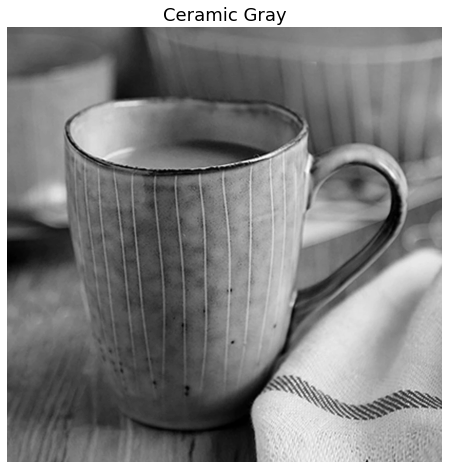

In [169]:
# Show the ceramic Image...
show_img(ceramic_gray, title = "Ceramic Gray", show_shape = True, shape = (10, 8))

In [119]:
# Resize the Ceramic Image to SOME POWER OF 2
ceramic_gray_resized = cv2.resize(ceramic_gray, (512, 512))

**Run the 2D FFT on GRAY CERAMIC with both MODES and compare it to the `fft` from `numpy` package...**

In [142]:
fft_ceramic_rec, fft_ceramic_mag_rec = get_fft(ceramic_gray_resized, mode = "recursive")
fft_ceramic_iter, fft_ceramic_mag_iter = get_fft(ceramic_gray_resized, mode = "iterative")

In [143]:
# Applying with NUMPY library.
f = np.fft.fft2(ceramic_gray_resized)
fshift = np.fft.fftshift(f)
np_mag = np.log(np.abs(fshift) + 1)

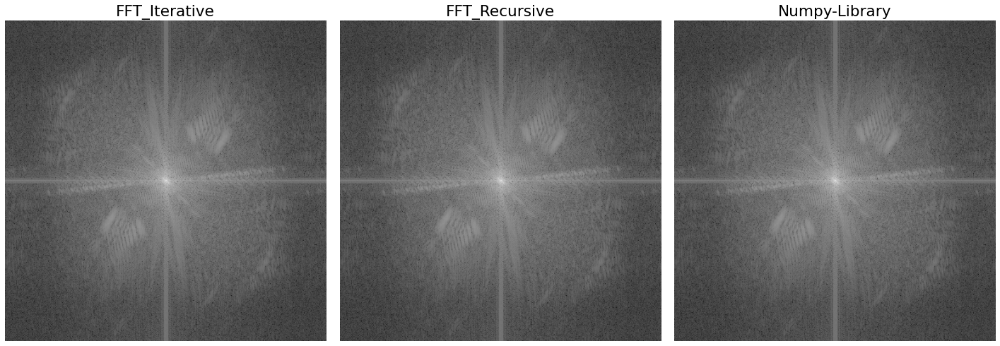

In [144]:
plotter(1, 3, [fft_ceramic_mag_iter, fft_ceramic_mag_rec, np_mag], ["FFT_Iterative", "FFT_Recursive", "Numpy-Library"], 
        mode = "GRAY", lim_enabled = False)

**Now we would compare the run-times of `2D-DFT` and `2D-FFT` for different image of size ($= 2^k$).**

In [219]:
# List containing Shapes for Image.
image_shapes = [2**k for k in range(3, 7)]
# Different Shaped Images...
ceramic_images = [cv2.resize(ceramic_gray, (shape, shape)) for shape in image_shapes]

# Time List for DFT and FFT...
time_dft = []# time for dft.
time_fft = []# time for fft.

for i in range(len(ceramic_images)):
    start_dft = timeit.default_timer()
    dft_image = DFT2D(ceramic_images[i])
    stop_dft = timeit.default_timer()
    time_dft.append(stop_dft - start_dft)

    start_fft = timeit.default_timer()
    fft_image = get_2d(ceramic_images[i], mode = "iterative")
    stop_fft = timeit.default_timer()
    time_fft.append(stop_fft - start_fft)

In [223]:
print("2D-DFT Time taken: ", time_dft)
print("2D-FFT Time taken: ", time_fft)

2D-DFT Time taken:  [0.019968836997577455, 0.3110672650000197, 5.052673947000585, 78.27885448699817]
2D-FFT Time taken:  [0.0011597789998631924, 0.002629999005876016, 0.006341102001897525, 0.01589954499650048]


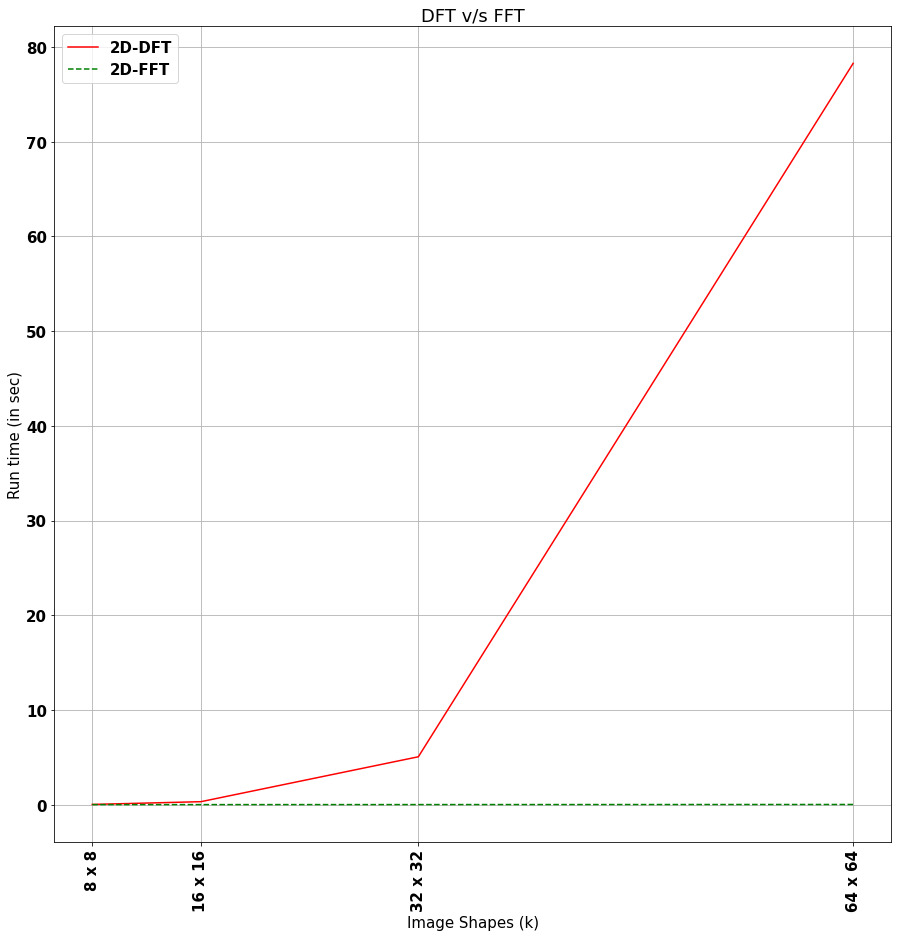

In [222]:
# Plot the Time takes for Different filter for Different sized Images...
mlp.rcParams.update({'font.size': 15})
plt.figure(figsize=(15, 15))
plt.plot(image_shapes, time_dft, color = "r", label = "2D-DFT")
plt.plot(image_shapes, time_fft, color = "g", linestyle = "--", label = "2D-FFT")
plt.xticks(image_shapes, [f"{shape} x {shape}" for shape in image_shapes], rotation = 90)
plt.title("DFT v/s FFT")
plt.xlabel("Image Shapes (k)")
plt.ylabel("Run time (in sec)")
plt.legend(loc="best")
plt.grid()
plt.show()

## Question 7.3 - 2D IFFT

Similarly, implement `2D inverse FFT`.

In [208]:
def get_ifft(data):
    """Using DUALITY of FOURIER Transform to convert the Frequency domain data to Spatial."""
    # take conjugate of the data...
    Fstar = np.conj(data)
    # Here duality of FT is peformed
    fstar = get_2d(Fstar)
    # Normalizing.
    fstar = fstar / np.product(data.shape)
    return np.conj(fstar)

In [157]:
# Let's plot the FT of Image.
fft_data = [fft_ceramic_rec, fft_ceramic_iter, f]
ifft_data_lst = ["Original", "IFT of FT due to Recursion", "IFT of FT due to Iteration", "IFT of FT due to Library"]
ifft_data = [ceramic_gray_resized]
for raw_data in fft_data:
    ifft_data.append(np.abs(get_ifft(raw_data)))

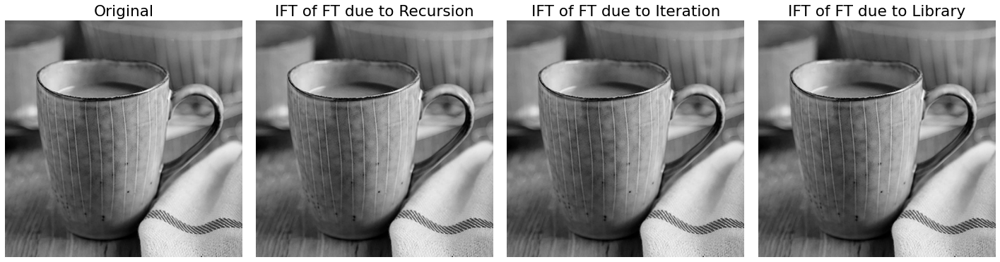

In [158]:
# Plot the Inverse FFT results and Original Image.
plotter(1, 4, ifft_data, ifft_data_lst, mode = "GRAY", lim_enabled = False)

## Question 7.4 - FT of FT

Calculate the Fourier transform of the **Fourier transform of any image**. How is it different from the original image? How can you fix this in the frequency domain so that we would get the original image back?

In [170]:
# FT of Image.
fft_ceramic_rec = get_2d(ceramic_gray_resized, mode = "recursive")
# FT of FTied Image.
fft_fft_ceramic_rec = get_2d(fft_ceramic_rec, mode = "recursive")

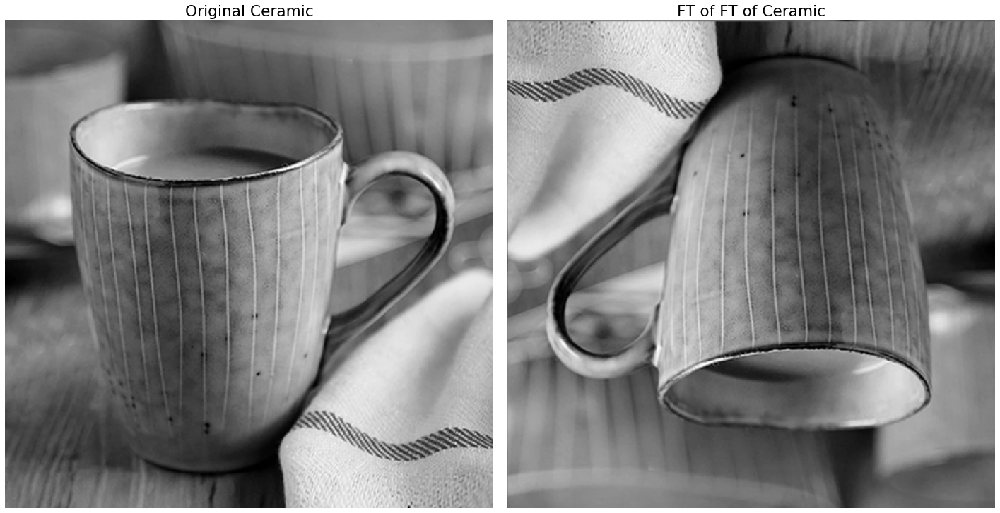

In [171]:
# Show both of them...
plotter(1, 2, [ceramic_gray_resized, np.abs(fft_fft_ceramic_rec)], ["Original Ceramic", "FT of FT of Ceramic"], 
        mode = "GRAY", lim_enabled = False)

**So the `FT(FT(Original Image)) = Inverted Image`, which can be corrected by taking `COMPLEX CONJUGATE` of `FT(Original Image)` which is still in FREQUENCY Domain.**

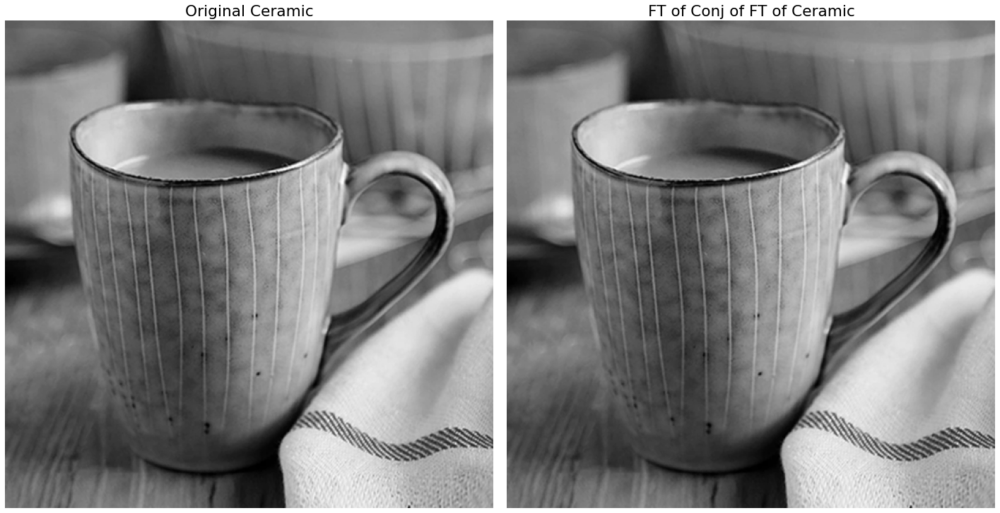

In [173]:
fft_fft_ceramic_corrected = get_2d(np.conj(fft_ceramic_rec))
# Plot the Original v/s Corrected.
plotter(1, 2, [ceramic_gray_resized, np.abs(fft_fft_ceramic_corrected)], ["Original Ceramic", "FT of Conj of FT of Ceramic"], 
        mode = "GRAY", lim_enabled = False)

**NOTE: HERE WE HAVE PUT `lim_enabled = False` TO AVOID DISPLAYING IMAGES IN RANGE \[0, 255\]. RATHER THE RANGE IS ADAPTIVE TO IMAGE `MIN` AND `MAX` VALUES.**

**If one wants to have the image back in \[0, 255\] range, he/she may feel free to do so.**

# Question 8

**(25 points) Low Pass Filtering using Fourier Transfrom**

In [207]:
# define IDEAL low pass filter...
def idealLowPassFilter(image_shape, cutoff_radius = 30):
    """
    This filter looks like a circular filter with white circle at centre of radius input by user.
    input:
        image_shape: TUPLE
    output:
        An Ideal Low Pass Filter
    """
    filter_arr = np.zeros(image_shape)
    N, M = image_shape
    for i in range(M):
        for j in range(N):
            if np.linalg.norm(np.array([i, j]) - np.array([M/2, N/2])) <= cutoff_radius:
                filter_arr[i, j] = 1
    return filter_arr

# Define Butterworth Pass Filter.
def butterworth_filter(image, order, cutoff_radius = 30, mode = "low"):
    """
    This is Modeification to Ideal Low Pass Filter as this has gentle cut-off  slope instead of step function
    like slope in Ideal Low Pass Filter.
    """
    filter_arr = np.zeros_like(image)
    N, M = image.shape
    if mode == "low":# Low Pass filter
        for i in range(M):
            for j in range(N):
                filter_arr[i, j] = 1/(1 + (np.linalg.norm(np.array([i, j]))/cutoff_radius)**(2*order))
        return filter_arr
    elif mode == "high":#High pass filter.
        for i in range(M):
            for j in range(N):
                filter_arr[i, j] = 1/(1 + (cutoff_radius/np.linalg.norm(np.array([i, j])))**(2*order))
        return filter_arr
    else:
        raise ValueError("Wrong mode!")

In [204]:
# Function that outputs -1 and +1 array.
def neg_pos_one_arr(image):
    # Construct array of -1 and +1.
    n, m = image.shape
    vm = np.array([(-1)**(k+1) for k in range(m)]).reshape(1, -1)
    vn = np.array([(-1)**(k+1) for k in range(n)]).reshape(-1, 1)
    # This is the Required Array.
    return np.outer(vn, vm)

# to apply filter in frequency domain -- define convolve_frequency
def frequency_domain_convolution(image, kernel, kernel_padding = False, mode = "recursive"):
    """
    This name given is a misnomer as convolution will be happened in spatial domain, while element by element
    multiplication will happen IN BETWEEN FFT(IMAGE) and FFT(kernel_spatial) in frequency domain.
    Output:
        Image+Kernel Convolution Result.
    """
    #Pad the Image...
    im_pad = np.zeros(2*np.asarray(image.shape))
    # Put image on Top-Left corner.
    im_pad[:image.shape[0], :image.shape[1]] = image
    # Instead of DOING FFT first and Then centre-shift manually in frequency domain. 
    # Multiplying -1 and +1 alternatively to padded image will do the same beforehand.
    centre_shift_im = im_pad*neg_pos_one_arr(im_pad)
    # Do FFT of the above Array.
    fft_pad_im = get_2d(centre_shift_im, mode = mode)
    # Pad the kernel if it is a SPATIAL one
    if kernel_padding:# true for SPATIAL one.
        kernel_pad = np.zeros(2*np.asarray(image.shape))
        kernel_pad[:kernel.shape[0], :kernel.shape[1]] = kernel
        # Centre shift...
        centre_shift_ker = kernel_pad*neg_pos_one_arr(kernel_pad)
        # FFT.
        kernel = get_2d(centre_shift_ker, mode = mode)
    # Perform element-wise multiplication...
    result = fft_pad_im*kernel
    # Compute Inverse Fourier Transform.
    ifft_im = get_ifft(result)
    # Return the Processed - Image.
    return ((ifft_im.real)*neg_pos_one_arr(ifft_im))[:image.shape[0], :image.shape[1]]# Also can use np.real()

In [214]:
# Resize the mountain gray to exponent of 2.
mountain_gray_resized = cv2.resize(mountain_gray, (256, 256))

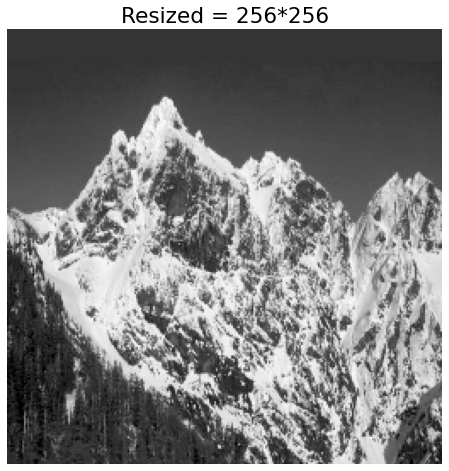

In [216]:
# Show the resized Image.
show_img(mountain_gray_resized, title = "Resized = 256*256", show_shape = False, mode = "GRAY")

## Question 8.1 - IDEAL Low Pass Filter

Apply `ideal lowpass filter` of cutoff radius, $D = 30$ in the frequency domain for image `mountain.png`. Also try for $D = 15$ and $50$. Include the original image and all three ideal lowpass filtered images and briefly discuss your results.

In [217]:
# FFT of mountain_gray version.
D_lst = [30, 15, 50]
filtered_imgs = [mountain_gray_resized]
# Double the mountain shape for padding purpose.
mountain_shape = tuple(2*np.asarray(mountain_gray_resized.shape))
for D in D_lst:
    kernel = idealLowPassFilter(mountain_shape, cutoff_radius = D)
    filtered_imgs.append(frequency_domain_convolution(mountain_gray_resized, kernel))

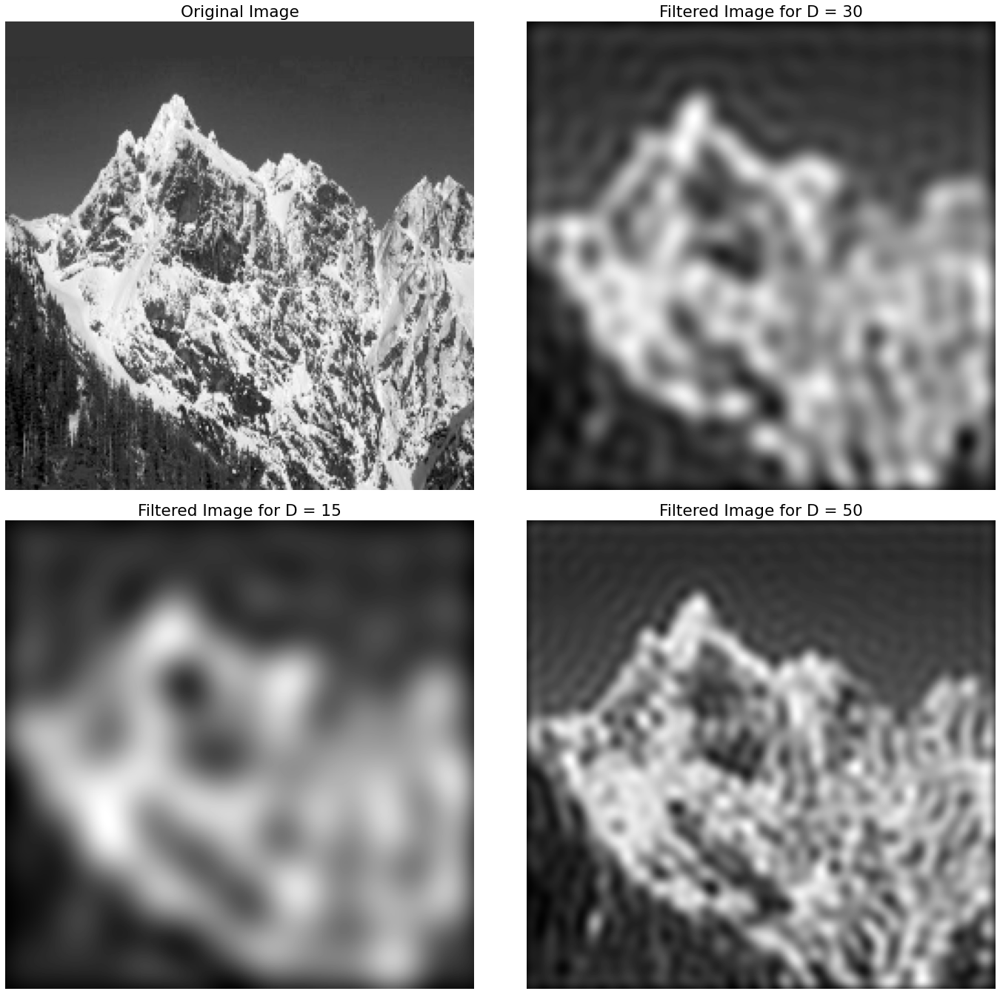

In [218]:
# Plot the Images Processed with Ideal Low Pass Filter with different D sizes.
titles_lst = [f"Filtered Image for D = {D}" for D in D_lst]
titles_lst.insert(0, "Original Image")
plotter(2, 2, filtered_imgs, titles_lst, mode = "GRAY", lim_enabled = False)

## Question 8.2 - Gaussian Low Pass Filter

Apply `gaussian lowpass filter` in the frequency domain for image `mountain.png`. Try for $D_0$ values $= 30, 15$ and $50$ ($D_0$ refers to the measure of spread in a gaussian curve). Include the original image and all three gaussian lowpass filtered images and briefly discuss your results.

In [219]:
# FFT of mountain_gray version.
D0_lst = [30, 15, 50]
filtered_imgs_gauss = [mountain_gray_resized]
# Double the mountain shape for padding purpose.
mountain_shape = tuple(2*np.asarray(mountain_gray_resized.shape))
for D in D_lst:
    gauss_kernel = gauss2D(shape = mountain_shape, sigma = D, method = None)
    filtered_imgs_gauss.append(frequency_domain_convolution(mountain_gray_resized, gauss_kernel))

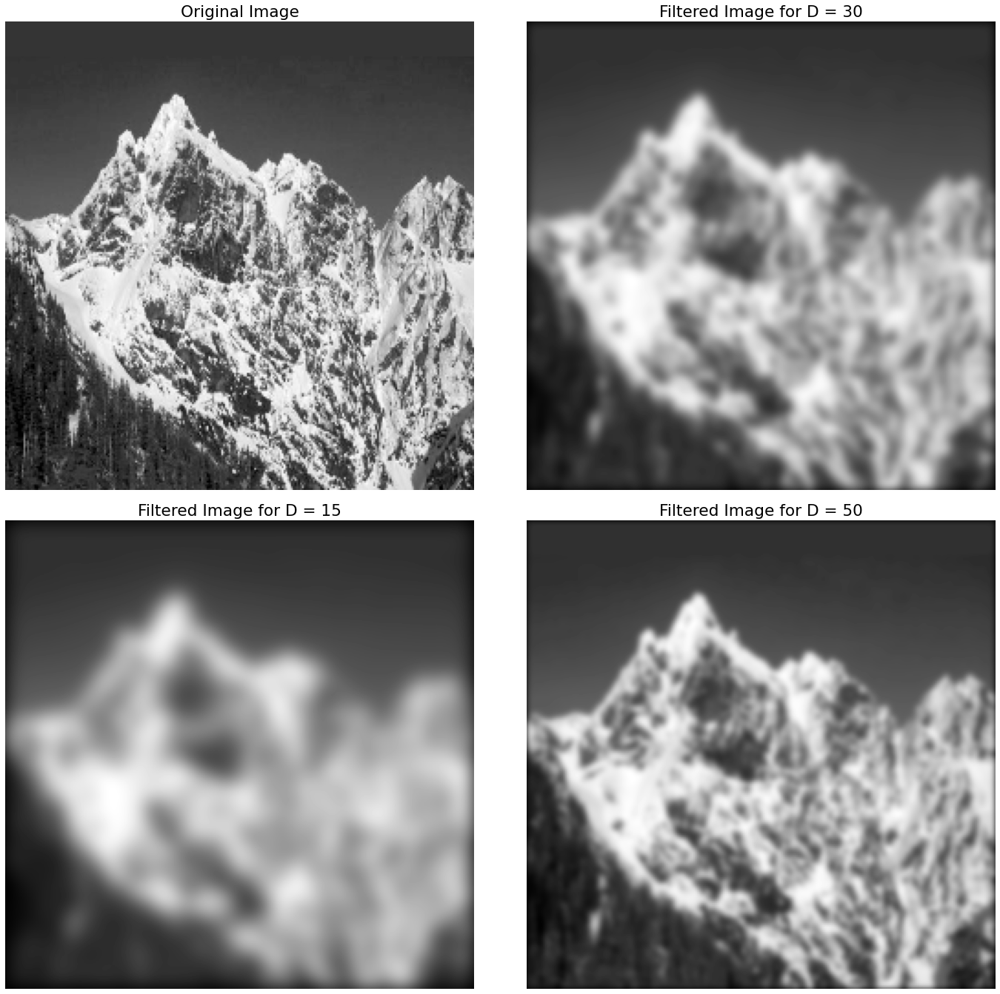

In [220]:
# Plot the Images Processed with Ideal Low Pass Filter with different D sizes.
titles_lst = [f"Filtered Image for D = {D}" for D in D0_lst]
titles_lst.insert(0, "Original Image")
plotter(2, 2, filtered_imgs_gauss, titles_lst, mode = "GRAY", lim_enabled = False)

## Question 8.3 - Gaussian v/s Ideal

Discuss the difference between your results for gaussian lowpass filtering and ideal lowpass filtering.

**Differences between Gaussian Low-Pass filtering and Ideal Low-Pass filtering.**
1. With `Ideal Low Pass` filtering, any high-frequency stuffs like edges are completely band-rejected. Hence extreme smoothing can be observed and also some `ringing` effects can be seen, which can be avoided with `butterpass` filter. And with increase in `D = cutoff radius` we can see more `crisper` image but the **ringing effects also get sharper** that deteriorates the view.
2. With `Gaussian Low Pass` filtering we don't have sharp cutoff frequency as in `Ideal Low pass`, as a result of which we can visualize some edges and that becomes more with increase in radius (i.e., allowing some of high-frequency signals to pass through). Here we don't see any `ringing` effects due to the smoothness of filter.

# Question 9 - Morphological Operations

**(25 points) Morphological Operations**

1. Morphological gradient is one of the morphological operators which is used for generating the outline of the image. The gradient can be obtained using a combination of morphological operators like `dilation`, `erosion`, `closing` and `opening`.
2. Explain the combination of operations and choice of structuring element used while performing morphological gradient on the input image `eye.png`.

**Refer:** [Morphological Gradient](https://en.wikipedia.org/wiki/Morphological_gradient)

In [73]:
# Define erosion, dilation, closing, and opening operations...
def erosion(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.zeros_like(image, dtype = 'uint8')
    req_thresh = np.sum(se)
    # x_cord and y_cord of Origin.
    cord = np.where(se == 2)
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            # Check if SE totally fits in Foreground...
            if np.sum(se*image[j:j+se_n, i:i+se_m]) == req_thresh:
                (im_copy[j:j+se_n, i:i+se_m])[cord[0][0], cord[1][0]] = 1
    return im_copy

# Define Dilation...
def dilation(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Filp SE around (0,0) coordinate.
    se = np.fliplr(np.flipud(se))
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.copy(image)
    # Patch that will be used in OR operation with Image Patch.
    tmp_patch = np.copy(se); cord = np.where(tmp_patch == 2)
    # Set the x_cord, y_cord of temporary SE as 1 -- will be used in OR operation.
    tmp_patch[cord[0][0], cord[1][0]] = 1
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            # Check if the Origin intersects with the Foreground, if yes then 
            if (image[j:j+se_n, i:i+se_m])[cord[0][0], cord[1][0]] == 1:
                # This is basically a Logical OR operation between SE and Image Patch.
                im_copy[j:j+se_n, i:i+se_m] = np.logical_or(image[j:j+se_n, i:i+se_m], tmp_patch).astype(np.uint8)
    return im_copy

#Define Opening...
# It can be defined as composition of Erosion then Dilation.
# But to save computation time we can implement in a separate method.
def opening(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.zeros_like(image, dtype = 'uint8')# Then put ones in it where required.
    req_thresh = np.sum(se)
    # Patch that will be used in OR operation with Image Patch.
    tmp_patch = np.copy(se); cord = np.where(tmp_patch == 2)
    # Set the x_cord, y_cord of temporary SE as 1 -- will be used in OR operation.
    tmp_patch[cord[0][0], cord[1][0]] = 1
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            if np.sum(se*image[j:j+se_n, i:i+se_m]) == req_thresh:
                # This is basically an Logical XOR operation between SE and Image Patch.
                im_copy[j:j+se_n, i:i+se_m] = np.logical_or(image[j:j+se_n, i:i+se_m], tmp_patch).astype(np.uint8)
    return im_copy

# Define Closing...
# It can be defined as composition of Dilation then Erosion.
# OR it can be defined DUAL of OPENING.
def closing(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    # We will take the DUAL operation to define closing.
    # reflected version of SE
    se = np.fliplr(np.flipud(se))
    # Take complement of Binary Image.
    image_comp = np.logical_not(image).astype(np.uint8)
    # take complement of opening of above two.
    return np.logical_not(opening(image_comp, se)).astype(np.uint8)

The shape of EYE Image = (561, 574, 3)


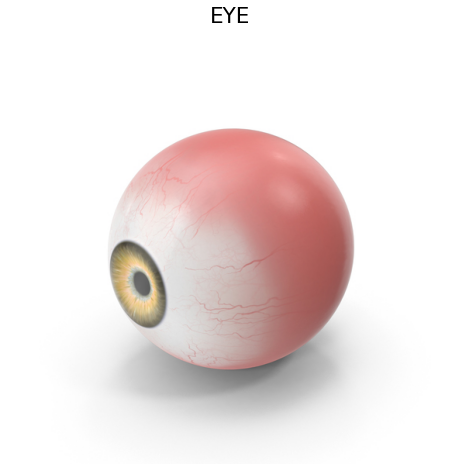

In [33]:
# Import eye.png
eye_im = cv2.imread("../images/eye.png")
show_img(eye_im, title="EYE")

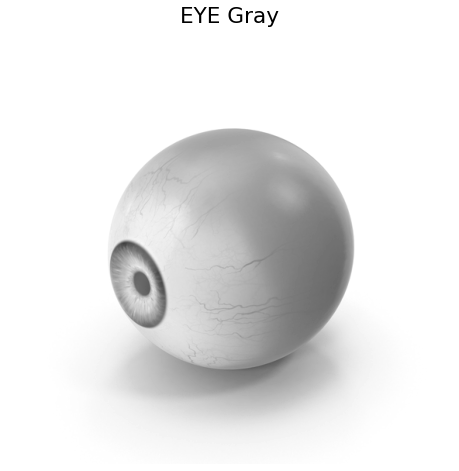

In [43]:
#Convert it to grayscale...
eye_gray = gray(eye_im)
show_img(eye_gray, title="EYE Gray", show_shape = False)

https://www.geeksforgeeks.org/python-thresholding-techniques-using-opencv-set-1-simple-thresholding/

The shape of EYE with Thresholding Image = (561, 574)


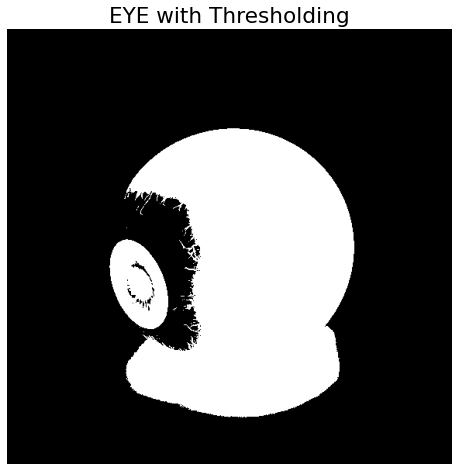

In [56]:
# Thresholding the Image to Binary form.
thresh, eye_threshed = cv2.threshold(eye_gray, 215, 255, cv2.THRESH_BINARY_INV)# cv2.THRESH_BINARY

# Show Binary Image.
show_img(eye_threshed, title = "EYE with Thresholding")

**According to definition for MORPHOLOGICAL Gradient:  The difference between the `dilation` and the `erosion` of a given image.**
$$G(f) = f \oplus b - f \ominus b,$$
where $f = $ image and $b = $ SE and where $\oplus$  and $\ominus$  denote the dilation and the erosion, respectively.

An **internal gradient** is given by:

$$G_{i}(f)=f-f\ominus b$$

While an **external gradient** is given by:

$$G_{e}(f)=f\oplus b-f$$

and $$G(f) = G_{i}(f) + G_{e}(f)$$

In [67]:
# def morphological gradient transformation.
def morphological_gradient_transformation(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    return dilation(image, se) - erosion(image, se)

In [75]:
# Convert Image to Binary form with entries 0 and 1.
eye_bin = (eye_threshed/255).astype(np.uint8)
# Define SE to be used for Computing MORPHOLOGICAL GRADIENT.
# 3*3 SEs
cross_se = np.array([[0,1,0],[1,2,1],[0,1,0]]).astype(np.uint8)
box_se = np.ones((3,3), dtype="uint8"); box_se[1, 1] = 2

In [77]:
# Apply morphological gradient transformation with BOTH type of SE.
edgy_eyes = []
ses = [cross_se, box_se]
for se in ses:
    edgy_eyes.append(255*morphological_gradient_transformation(eye_bin, se))

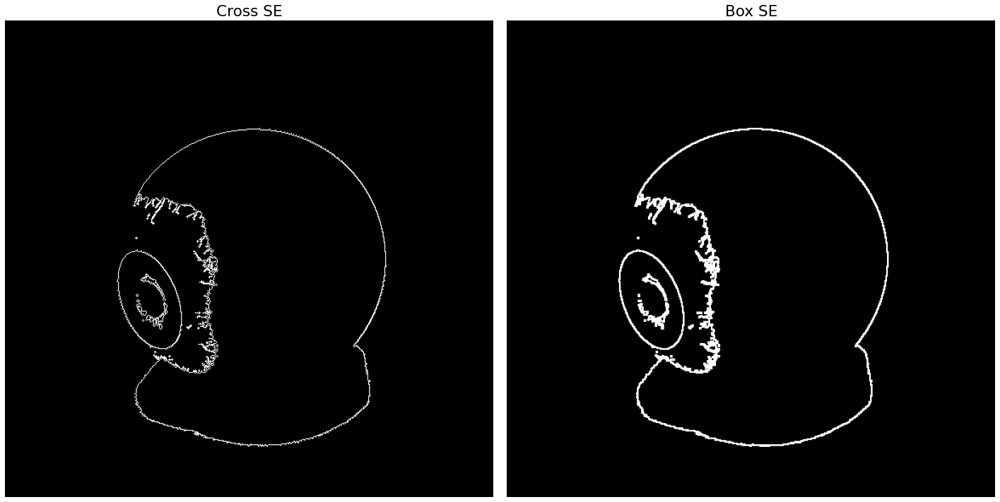

In [78]:
# Plot the Edgy Images.
plotter(1, 2, edgy_eyes, ["Cross SE", "Box SE"], mode = "GRAY", lim_enabled = False)

# Question 10 - Rotation Transformation

**(30 points) Geometrical Transformations**

1. Write a function `rotImage` which rotates an input image about its center and takes the following parameters:
    * Input Image
    * Angle of rotation in degrees
    * **Note:** The output dimensions should accommodate the entire image (without cropping) after rotation.
2. Show outputs of a rectangular image of your choice with angle 30°, 45°, 90° and 2 other angles of your choice.

https://www.cs.auckland.ac.nz/courses/compsci773s1c/lectures/ImageProcessing-html/topic2.htm

https://cristianpb.github.io/blog/image-rotation-opencv

In [76]:
# Rotate the Image...
def rotImage(image, angle):
    """
    * image: Input Image
    * angle: Angle of rotation in degrees
    * The output dimensions should accommodate the entire image (without cropping) after rotation.
    """
    if image.ndim == 2:
        #diag_length = 
        cos = np.round(np.cos(angle*np.pi/180), 3)
        sin = np.round(np.sin(angle*np.pi/180), 3)
        # Define new height and width of Image.
        h, w = image.shape
        output_w = np.abs(w*cos) + np.abs(h*sin)
        output_h = np.abs(w*sin) + np.abs(h*cos)
        # Output Image.
        result_img = np.zeros((round(output_h) + 2, round(output_w) + 2))
        # Output Image-Shape.
        oh, ow = result_img.shape
        # Define Rotation Matrix.
        rot_matrix = np.array([[cos, -1*sin, 0],
                               [sin, cos, 0],
                               [0, 0, 1]])
        # Take inverse of the Composition of Rotation and Translation matrix...
        transformation_mat_inv = np.linalg.inv(rot_matrix)#np.dot(, translate_mat)
        # Define Translation matrix for Input image...
        input_translate_mat = np.array([[1, 0, w/2],
                                        [0, 1, h/2],
                                        [0, 0, 1]])
        # Apply these transformation on co-ordinates of output...
        for i in range(oh):
            for j in range(ow):
                # Input Image Co-ordinates
                input_img_cord = np.dot(transformation_mat_inv, np.array([j-(ow/2), i-(oh/2), 1]).reshape(-1, 1))
                #print(input_img_cord)
                #Check if img_cord are in range or not.
                if -w/2< input_img_cord[0][0] <=w/2 and -h/2< input_img_cord[1][0] <= h/2:
                    #print("hit!")
                    new_cords = np.dot(input_translate_mat, input_img_cord)
                    integral_cords = np.int32(np.floor(new_cords))
                    bx, by = integral_cords[0][0], integral_cords[1][0]
                    a = new_cords[0][0] - bx
                    b = new_cords[1][0] - by
                    # Apply bilinear transformation...
                    if (bx + 1) < w and (by + 1) < h:
                        result_img[i, j] = np.uint8((1-a)*(1-b)*image[by, bx] + a*(1-b)*image[by, bx + 1]
                                                    + a*b*image[by + 1, bx + 1] + (1-a)*b*image[by + 1, bx])
        return result_img
    elif image.ndim == 3:
        output = []
        output.append(rotImage(image[..., 0], angle = angle))
        output.append(rotImage(image[..., 1], angle = angle))
        output.append(rotImage(image[..., 2], angle = angle))
        return np.dstack(output)
    else:
        raise ValueError("Check if the Image is in Correct Format!")

The shape of JUG image Image = (895, 640, 3)


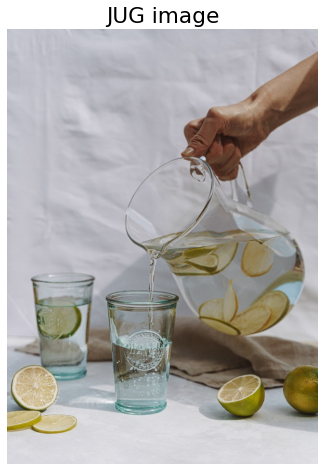

In [27]:
# read the JUG image.
jug = cv2.imread("../images/jug.jpg")
show_img(jug, title = "JUG image")

In [72]:
# Rotate The Image...
rotated_jug = rotImage(jug, 45)

The shape of Rotated Jug Image = (1087, 1087, 3)


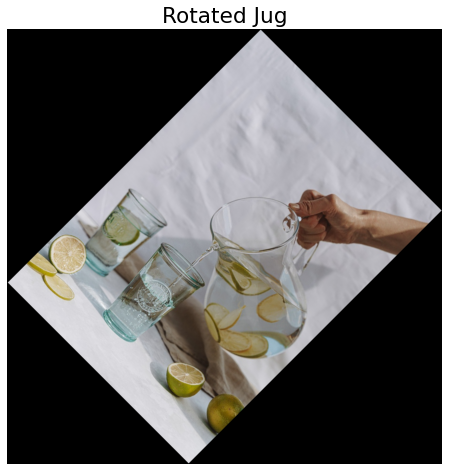

In [73]:
# Show Image...
show_img(rotated_jug.astype(np.uint8), title = "Rotated Jug", lim_enabled = False)

In [77]:
# List of Angles...
angles = [30, 45, 90, 135, 180]
rotated_imgs = []
for angle in angles:
    rotated_imgs.append((rotImage(jug, angle)).astype(np.uint8))

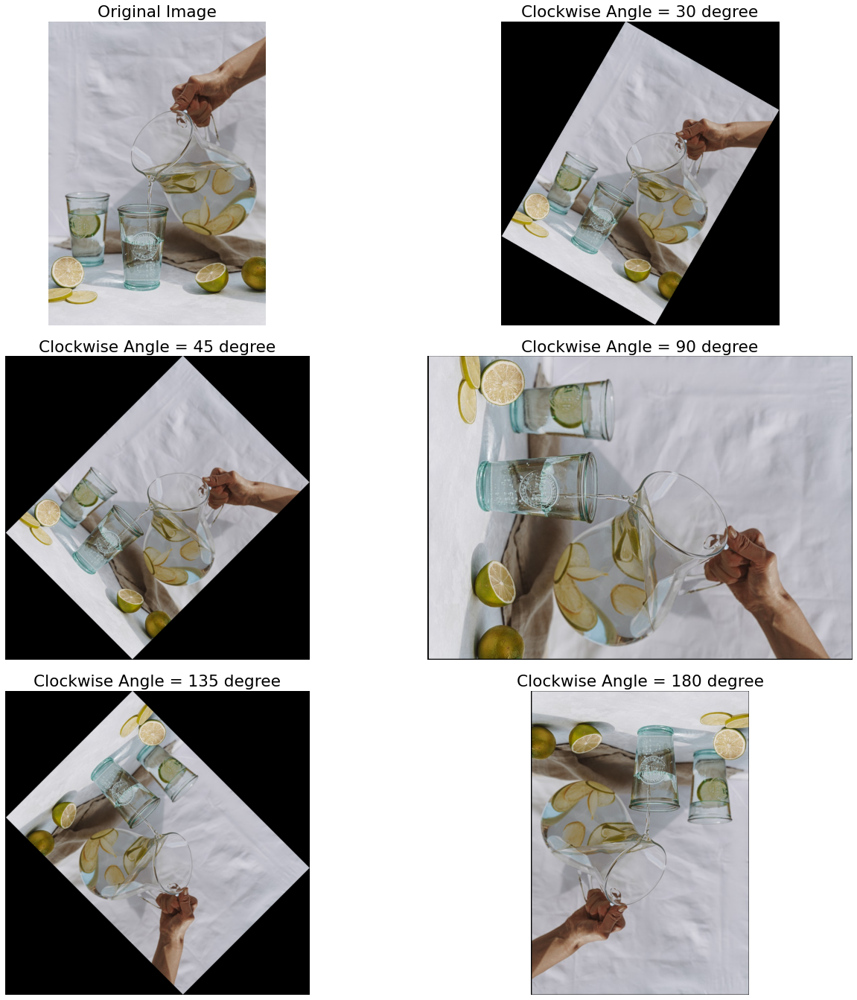

In [78]:
# Show ALL Images...
rotated_imgs.insert(0, jug)
rotated_titles = [f"Clockwise Angle = {angle} degree" for angle in angles]
rotated_titles.insert(0, "Original Image")
plotter(3, 2, rotated_imgs, rotated_titles, mode = "RGB", lim_enabled = False)

# Question 11 - Denoising

**(15 points) Image Denoising**

Use a combination of any of the techniques in this assignment to bring `corruptedLena.jpg` as close to `lena.jpg` as possible. Explain your process.

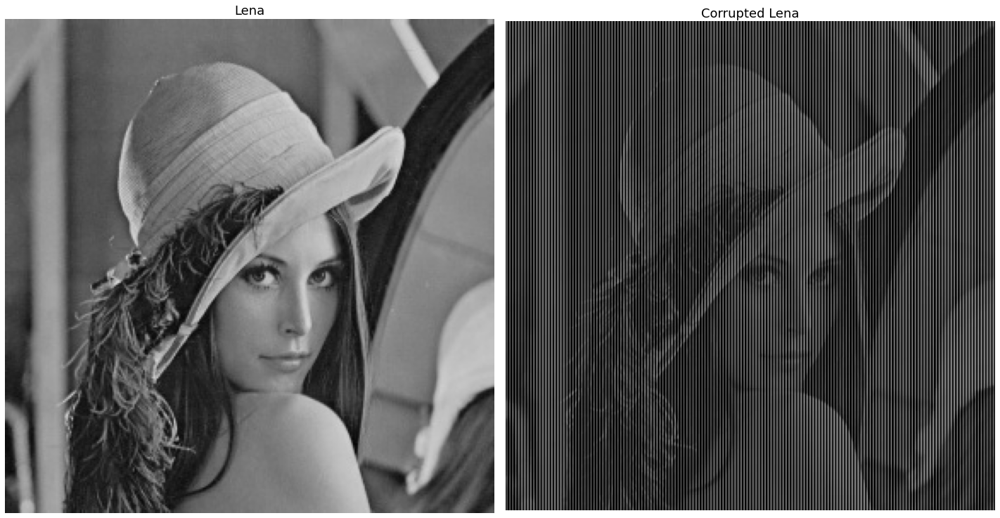

In [175]:
# Import corruptedLena.jpg
corruptedLena = cv2.imread("../images/corruptedLena.jpg")
lena = cv2.imread("../images/lena.jpg")
plotter(1, 2, [lena, corruptedLena], ["Lena", "Corrupted Lena"])

In [177]:
#Convert both to one-channel mode.
corruptedLena_gray = gray(corruptedLena)
lena_gray = gray(lena)
# Resize corruptedLena_gray and lena_gray to size of power of 2.
corruptedLena_gray = cv2.resize(corruptedLena_gray, (512, 512))

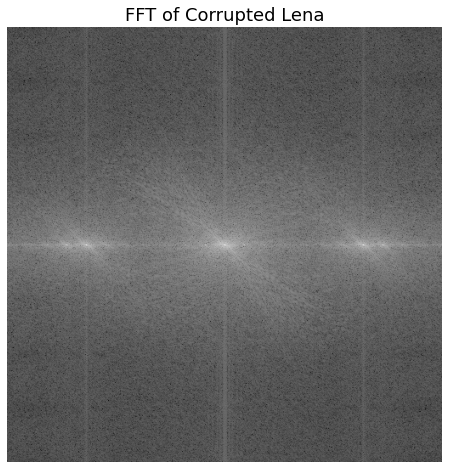

In [178]:
# Apply FFT on corruptedLena
fft_corruptedLena, mag_corruptedLena = get_fft(corruptedLena_gray)
show_img(mag_corruptedLena, title = "FFT of Corrupted Lena", show_shape = False, lim_enabled = False)

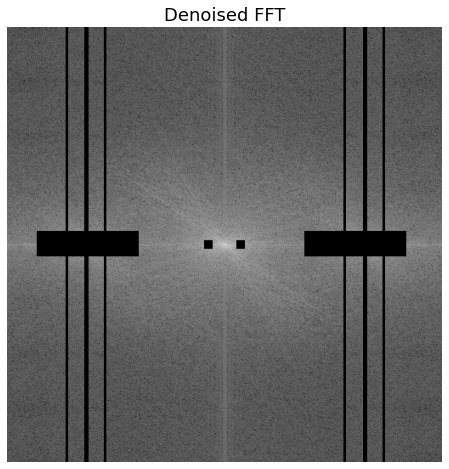

In [231]:
# Supress the noises that we see away from centre after centre shifting...
raw_im = shift_dft(fft_corruptedLena)
# supress...
raw_im[ : , 91:96] = 0.
raw_im[ : , 419:424] = 0.

raw_im[ : , 69:72] = 0.
raw_im[ : , 442:445] = 0.

raw_im[ : , 114:117] = 0.
raw_im[ : , 396:399] = 0.

raw_im[240:270, 35:155] = 0.
raw_im[240:270, 350:470] = 0.

raw_im[251:261, 232:242] = 0.
raw_im[251:261, 270:280] = 0.

#raw_im[250:255, :235] = 0.
#raw_im[250:255, 275:] = 0.

#raw_im[ :225, 245:255] = 0.
#raw_im[290: , 245:255] = 0.

# Obtain the magnitude from above raw_im...
mag_raw_im = np.log(np.abs(raw_im) + 1)
show_img(mag_raw_im, title = "Denoised FFT", show_shape = False, lim_enabled = False)

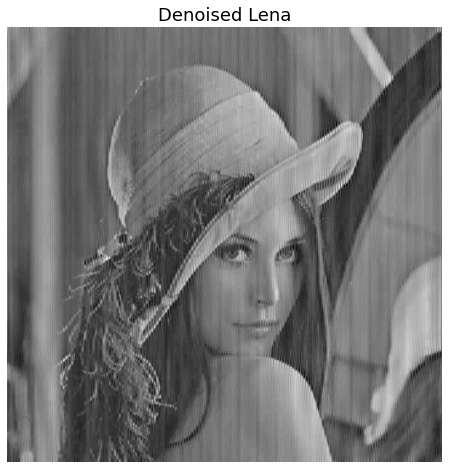

In [232]:
# Let's see how the IFFT of denoised FFT looks like...
lenaCorrected = np.abs(get_ifft(raw_im))
lenaScaled = (255*(lenaCorrected - lenaCorrected.min())/(lenaCorrected.max() - lenaCorrected.min())).astype(np.uint8)
show_img(lenaScaled, title = "Denoised Lena", show_shape = False, lim_enabled = False)

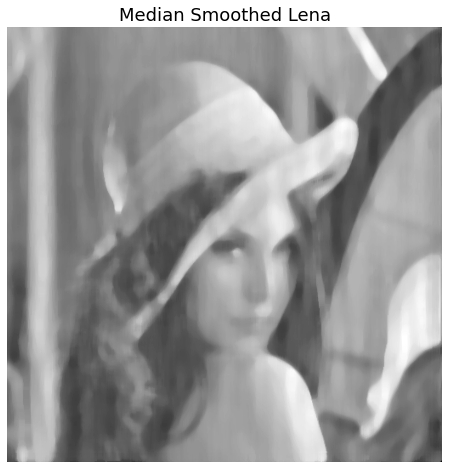

In [233]:
# Apply median filter to see...
lena_median = medianFilter(lenaScaled, 3)
show_img(lena_median, title = "Median Smoothed Lena", show_shape = False, lim_enabled = False)

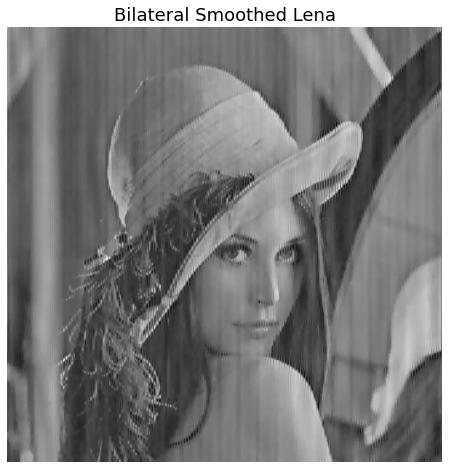

In [234]:
# Apply Bilateral filter...
lenaBilateral = bilateralFiltering(lenaScaled, 5, 200, 10)
show_img(lenaBilateral, title = "Bilateral Smoothed Lena", show_shape = False, lim_enabled = False)

**Tried ALL sorts of NOISE removal techniques and the best that I can achieve is with `Frequency Domain Removal of Periodic Noise` (i.e. `Band-Reject` + `Notch Filtering`) and then `Bilateral Filtering` for some smoothing the FRINGES and then rescaling back it to \[0, 255\] range to increase CONTRAST (i.e., `Contrast Stretching`).**

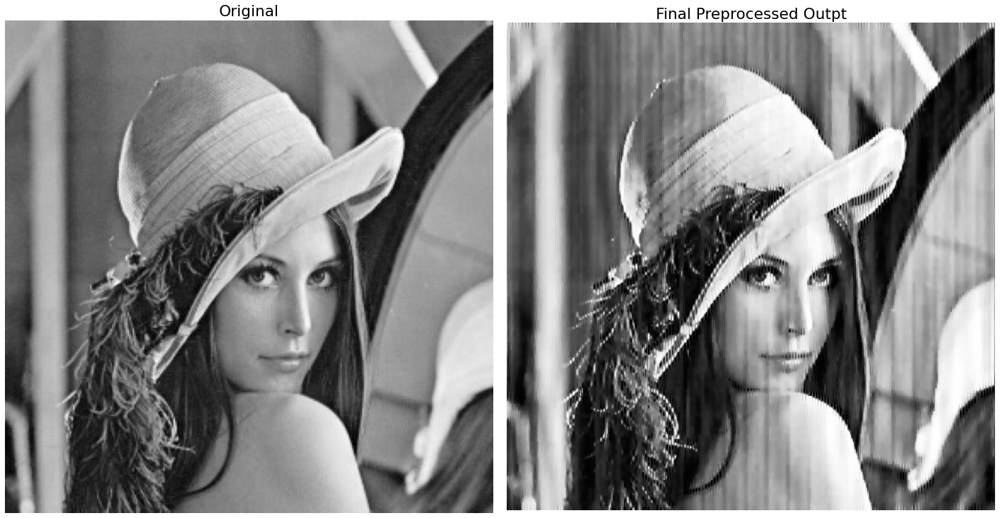

In [235]:
mlp.rcParams.update({"font.size": 18})
lenaBilateral_ = (255*(lenaBilateral - lenaBilateral.min())/(lenaBilateral.max() - lenaBilateral.min())).astype(np.uint8)
lenaBilateral_contrast = cv2.equalizeHist(lenaBilateral_)
plotter(1, 2, [lena_gray, lenaBilateral_contrast], ["Original", "Final Preprocessed Outpt"], mode = "GRAY", lim_enabled = False)

**The ADDITIONAL fringes are due to `some HIGH frequencies` vertical lines away from centre that we can't see properly at those RECTANGULAR BLACKED-OUT region. Because the point where we `white` illumination on x-axis through that the FFT of image consists of white-vertical lines that we can't see properly.**

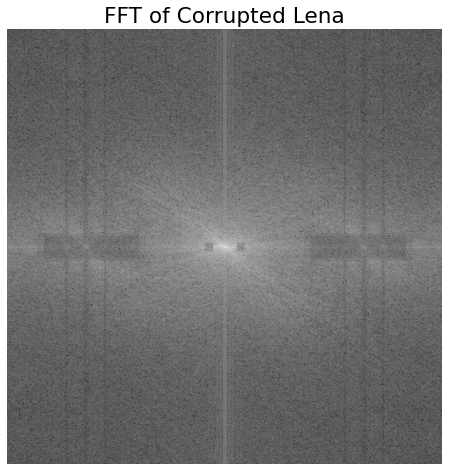

In [236]:
# Apply FFT on corruptedLena
fft_corruptedLena_, mag_corruptedLena_ = get_fft(lenaBilateral_contrast)
show_img(mag_corruptedLena_, title = "FFT of Corrupted Lena", show_shape = False, lim_enabled = False)

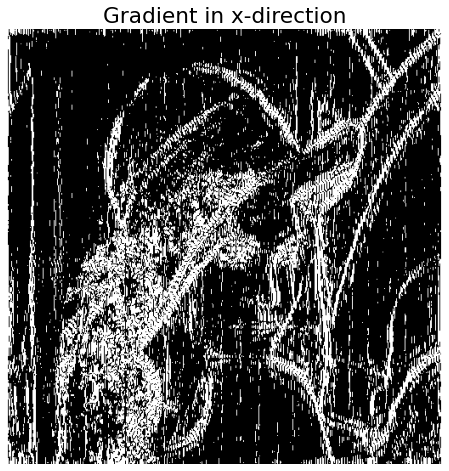

In [237]:
#Let's see edges only in y-direction i.e., Gradient in x-direction.
threshold = 50
G_x_abs = np.abs(convolve2D(lenaScaled, sobel_x, padding="auto"))
G_x_abs = ((G_x_abs > threshold).astype(np.uint8))*255
show_img(G_x_abs, title = "Gradient in x-direction", show_shape = False, lim_enabled = False)

# Rough

In [134]:
from functools import reduce

In [136]:
reduce(np.multiply, ceramic_gray_resized.shape)

262144

https://forum.image.sc/t/questions-about-the-5x5-sobel-filter-in-directionality-plugin/10230

https://stackoverflow.com/questions/31728948/what-are-the-kernel-coefficients-for-opencvs-sobel-filter-for-sizes-larger-than